# Setup

## Libraries

In [3]:
import numpy as np
import pandas as pd
from scipy.stats._continuous_distns import norm
import pickle

import matplotlib.pyplot as plt
# from matplotlib.lines import Line2D
from pathlib import Path
import netCDF4 as nc
import xarray as xr
import importlib
import src.mstmeclass as mc
import src.stme as stme
from scipy.spatial import KDTree
from scipy.spatial.distance import directed_hausdorff
from sklearn.metrics.pairwise import euclidean_distances
import cartopy.crs as ccrs
from statsmodels.distributions.empirical_distribution import ECDF


In [4]:
region = "caribbean"
rf = 'none'
# rf = 'h-east'
# rf = 'none'
depth = -100

match region:
    case "guadeloupe":
        dir_data = "./ww3_meteo"
        dir_bathy = "./Bathy.nc"
        min_lon = -62.00
        min_lat = 15.80
        max_lon = -60.80
        max_lat = 16.60
        dir_tracks = "./tracks"
        occur_freq = 44 / (2021 - 1971 + 1)
    # the cyclones were selected as passing at distance of 200km from Guadeloupe.
    # According to IBTrACS, there were 44 storms of class 0~5 during 1971-2021
    case "caribbean":
        dir_data = "./ww3_meteo_slim"
        dir_bathy = "./Bathy.nc"
        min_lon = -65.00
        min_lat = 12.00
        max_lon = -58.00
        max_lat = 18.00
        dir_tracks = "./tracks"
        occur_freq = 44 / (2021 - 1971 + 1)
ds_path = Path(f"./ds_filtered_{region}.txt")
ds_track_path = Path(f"./ds_track_{region}.txt")

# get stm from previous result
with open(Path(f'./output/{region}/GP{80}%_CM{80}%/mstme_pickle.txt'),'rb') as f:
    mstme = pickle.load(f)
stm = mstme.stm
num_events = mstme.num_events
num_vars = mstme.num_vars
exp_series=[]
for i in range(num_events):
    exp_series.append(xr.open_dataset(f'./exp_series/{i:03d}.nc'))

var_name    = ["$H_s$", "$U$"]
var_name_g  = ['$\hat H_s$', '$\hat U$']
unit        = ['[m]','[m/s]']

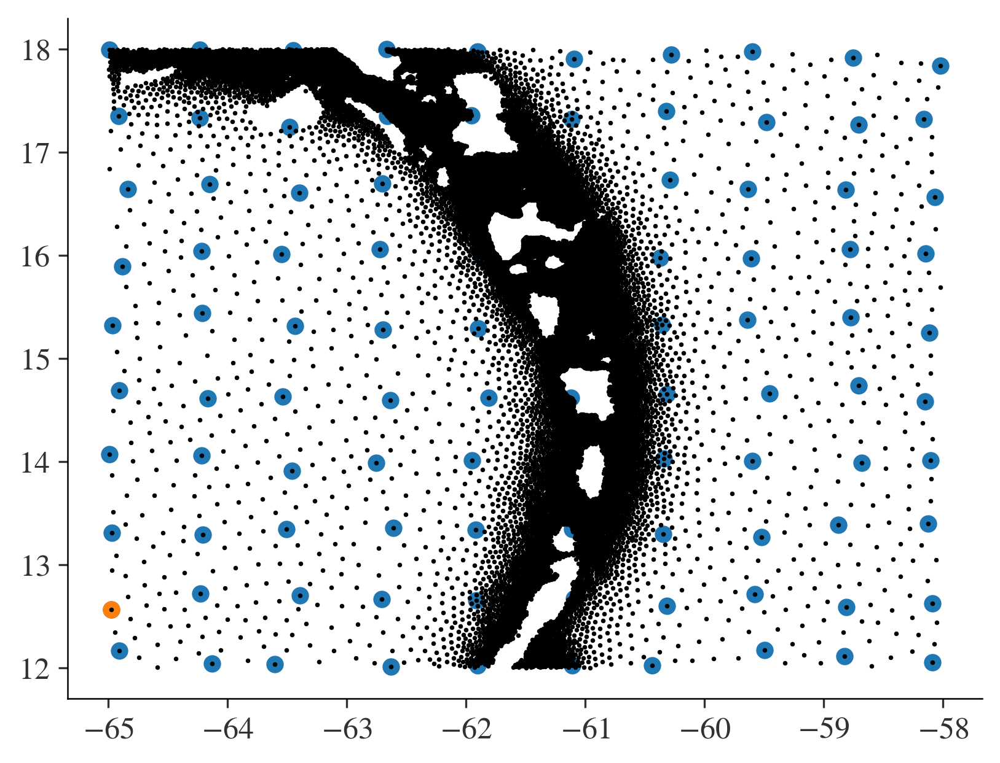

In [5]:
# tree = KDTree(mstme.latlon)
# _, pos_list = tree.query(
#     [[16.150 - i * 0.05, -61.493] for i in range(4)]
# )
tree = KDTree(mstme.latlon)
grid_res = 10
lat_list = np.linspace(min_lat,max_lat,grid_res)
lon_list = np.linspace(min_lon,max_lon,grid_res)
dist_list, pos_list = tree.query(
    [[[lat, lon] for lat in lat_list] for lon in lon_list]
)
pos_list = pos_list.flatten()
plt.scatter(mstme.latlon[pos_list,1], mstme.latlon[pos_list,0])
plt.scatter(mstme.latlon[pos_list[1],1], mstme.latlon[pos_list[1],0])
plt.scatter(mstme.latlon[:,1], mstme.latlon[:,0],s=1,c='black')

Text(0.0, 1.0, 'Location 0')

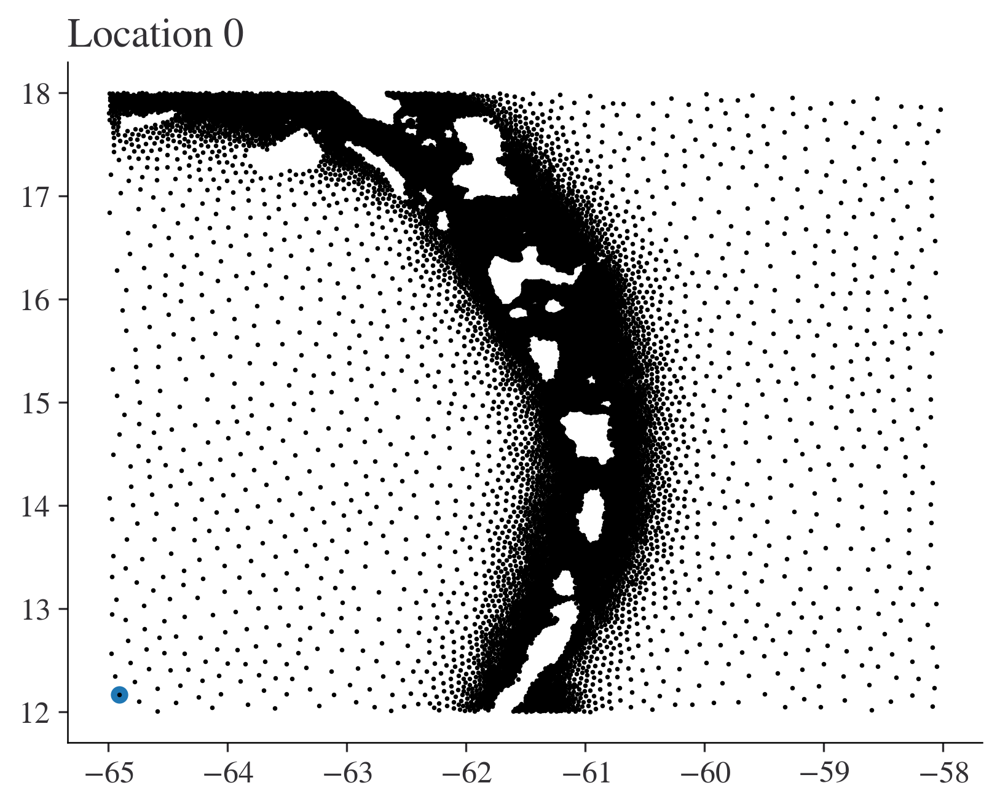

In [6]:
plt.scatter(mstme.latlon[pos_list[0],1], mstme.latlon[pos_list[0],0])
plt.scatter(mstme.latlon[:,1], mstme.latlon[:,0],s=1,c='black')
plt.title('Location 0')

# Calculate Everything

In [7]:
res= 50
dist_method = ['MD', 'Hausdorff']
di = 0

# [0,1]
_bins = np.linspace(0,1,res,endpoint=False)
# exp_unique_all = []
k_dict = {
   'k_null':[],
   'k':[],
   }
for pi,pos in enumerate(pos_list):
  # fig, ax = plt.subplots(2,num_vars,figsize=(4*num_vars,4*2),facecolor="white")

  k_arr = []
  k_null_arr = []
  for vi in range(num_vars):
    num_events_ext = np.count_nonzero(mstme.is_e[vi])
    stm_ext = mstme.stm[vi,mstme.is_e[vi]]
    exp_series_ext = [exp_series[i] for i in np.where(mstme.is_e[vi])[0]]

    # Quantize
    # fig_q, ax_q = plt.subplots(
    exp_unique = []
    exp_array = np.zeros((num_events_ext,res,res))
    for ei in range(num_events_ext):
      h = exp_series_ext[ei].isel(node=pos)['hs']
      u = exp_series_ext[ei].isel(node=pos)['UV_10m']
      # subtract 1 from digitize because 0.0~0.1 will return 1 and 0.9~1.0 will return res(and will cause indexerror)
      _exp_digitized = np.digitize(np.array([h,u]).T,_bins)-1
      _exp_digitized_unique = np.unique(_exp_digitized,axis=0)
      exp_unique.append(_exp_digitized_unique)

      array = np.zeros((res,res))
      for cell in _exp_digitized_unique:
          try:
            array[cell[0],cell[1]]=1
          except IndexError:
            print(ei,cell)
      exp_array[ei,:,:]=array

    # distance matrix
    d_mat = np.empty((num_events_ext,num_events_ext))
    if dist_method[di] == 'MD':
      for i in range(num_events_ext):
        for j in range(i,num_events_ext):
          _d = np.sum(np.abs(exp_array[i]-exp_array[j]))
          d_mat[i,j]=_d
          d_mat[j,i]=_d
    elif dist_method[di] == 'Hausdorff':
      for i in range(num_events_ext):
        for j in range(i,num_events_ext):
          _d, _, _ = directed_hausdorff(exp_unique[i],exp_unique[j])
          d_mat[i,j]=_d
          d_mat[j,i]=_d
    # d_mat_list = [d_mat,d_mat_h]
    


    # null distribution of k
    count = (num_events_ext**2-num_events_ext)//2-(num_events_ext-1)
    k_null = []
    for ri in range(250):
      _idx_list=np.arange(num_events_ext)
      np.random.shuffle(_idx_list)
      d_mat_sorted_random = d_mat[_idx_list,:][:,_idx_list]
      _k = 0
      for i in range(num_events_ext-2):
          for j in range(i+1,num_events_ext-1):
              if d_mat_sorted_random[i,j]<d_mat_sorted_random[i,j+1]: _k+=1
      k_null.append(_k/count)
    k_null_arr.append(k_null)

    # sorted DM
    idx_list = stm_ext.argsort()
    d_mat_sorted = d_mat[idx_list,:][:,idx_list]

    # realization of k for this distribution of DM
    k = 0
    for i in range(num_events_ext-2):
        for j in range(i+1,num_events_ext-1):
            if d_mat_sorted[i,j]<d_mat_sorted[i,j+1]: k+=1
    k_arr.append(k/count)
    
    # prepare figures
    # fig.suptitle(f'{dist_method[di]} distance Location {pos}: ({mstme.latlon[pos,0]:.4f},{mstme.latlon[pos,1]:.4f})',size=10)
    # ax[0,vi].set_title(f'STM:{var_name[vi]}')
    # ax[0,vi].tick_params(top=True,labeltop=True, bottom=False, labelbottom=False)
    # ax[0,vi].imshow(d_mat_sorted)
    # ax[0,vi].tick_params(top=True,labeltop=True, bottom=False, labelbottom=False)
    # ax[1,vi].hist(k_null)
    # ax[1,vi].axvline(k/count,c='red')
    # print(f'{k/count*100:.2f}% of SD increases as STM of H increases')
  
  # path_out = Path(f'./output/{region}/GP{80}%_CM{80}%/dm/{dist_method[di]}/')
  # if not path_out.exists():
  #     path_out.mkdir(parents=True, exist_ok=True)
  # plt.savefig(path_out/f'{pi:03d}_{pos}.pdf', bbox_inches="tight")
  # plt.savefig(path_out/f'{pi:03d}_{pos}.png', bbox_inches="tight")
  k_dict['k'].append(k_arr)
  k_dict['k_null'].append(k_null_arr)

  # exp_unique_all.append(exp_unique)


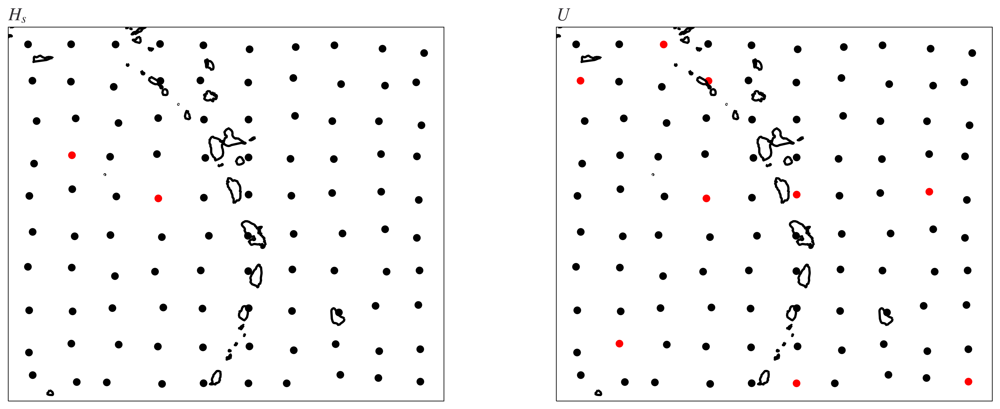

In [8]:
fig,ax=plt.subplots(1,num_vars,figsize=(8*2,6),subplot_kw={"projection": ccrs.PlateCarree()},)
for vi in range(num_vars):
  pval=[]
  for pi,pos in enumerate(pos_list):
  # print(pct[0],pct[1])
    _mean = np.mean(k_dict['k_null'][pi][vi])
    _ecdf = ECDF(k_dict['k_null'][pi][vi]-_mean)
    # pct = np.percentile(k_dict['k_null'][pi][vi],[2.5,97.5])
    _pval = 2*(1-_ecdf(np.abs(k_dict['k'][pi][vi]-_mean)))
    pval.append(_pval)
  _c = ["red" if p < 0.05 else "black" for p in pval]
  ax[vi].coastlines(lw=2)
  ax[vi].scatter(mstme.latlon[pos_list,1],mstme.latlon[pos_list,0],c=_c)
  ax[vi].set_title(f'{var_name[vi]}')

# Each location, each TC

Text(0.0, 1.0, 'Exposure trajectory for TC#0 at Location 3823: (12.1665,-64.9086)')

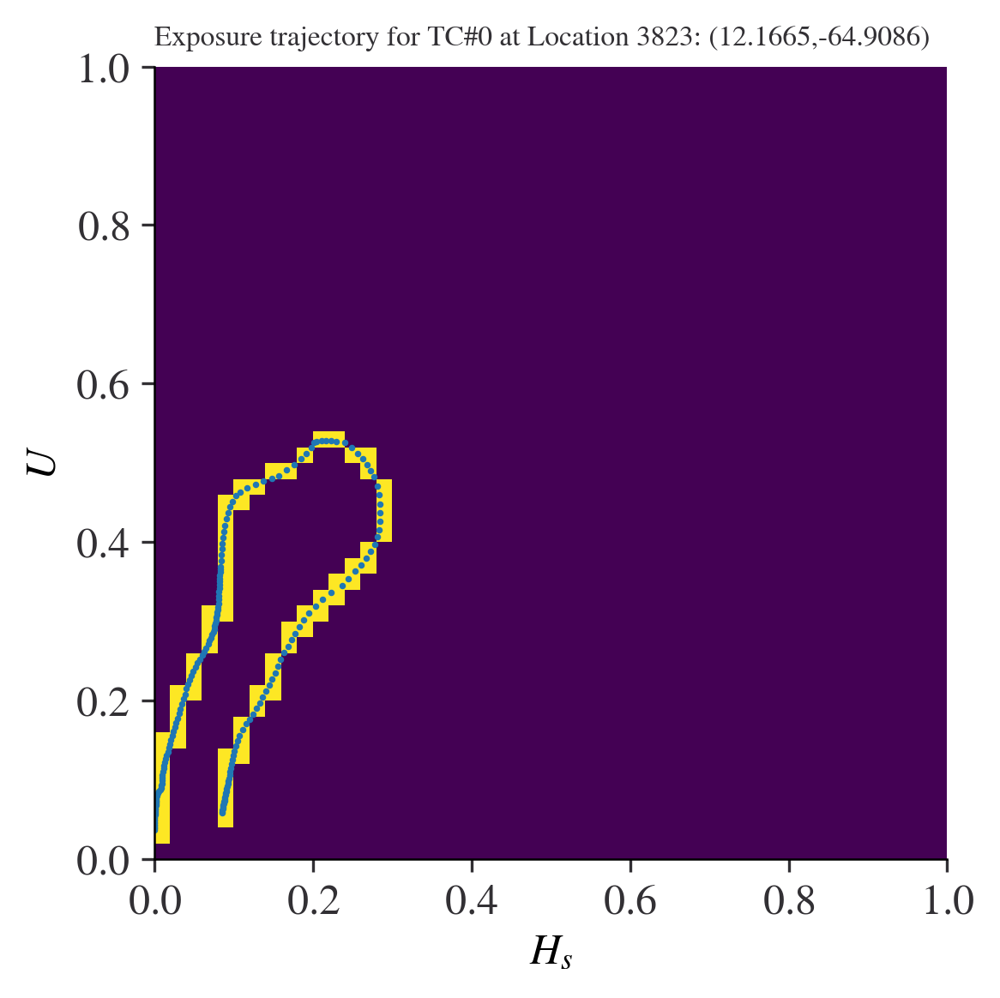

In [4]:
res = 50
dist_method = ["MD", "Hausdorff"]
di = 0

# [0,1]
_bins = np.linspace(0, 1, res, endpoint=False)

k_dict = {
  "k_null": [],
  "k": [],
}

pi = 0
pos = pos_list[pi]
vi = 0

num_events_ext = np.count_nonzero(mstme.is_e[vi])
stm_ext = mstme.stm[vi, mstme.is_e[vi]]
exp_series_ext = [exp_series[i] for i in np.where(mstme.is_e[vi])[0]]

# Quantize
# fig_q, ax_q = plt.subplots(
exp_unique = []
exp_array = np.zeros((num_events_ext, res, res))
for ei in range(num_events_ext):
    h = exp_series_ext[ei].isel(node=pos)["hs"]
    u = exp_series_ext[ei].isel(node=pos)["UV_10m"]
    # subtract 1 from digitize because 0.0~0.1 will return 1 and 0.9~1.0 will return res(and will cause indexerror)
    _exp_digitized = np.digitize(np.array([h, u]).T, _bins) - 1
    _exp_digitized_unique = np.unique(_exp_digitized, axis=0)
    exp_unique.append(_exp_digitized_unique)

    array = np.zeros((res, res))
    for cell in _exp_digitized_unique:
        try:
            array[cell[0], cell[1]] = 1
        except IndexError:
            print(ei, cell)
    exp_array[ei, :, :] = array

fig, ax = plt.subplots(1, 1, figsize=(4, 4))

ei = 0
ax.imshow(exp_array[ei].T, origin="lower", extent=(0, 1, 0, 1))
ax.scatter(
    exp_series_ext[ei].isel(node=pos)["hs"],
    exp_series_ext[ei].isel(node=pos)["UV_10m"],
    s=1,
)
ax.set_xlabel(var_name[0])
ax.set_ylabel(var_name[1])
ax.set_title(
    f"Exposure trajectory for TC#{ei} at Location {pos}: ({mstme.latlon[pos,0]:.4f},{mstme.latlon[pos,1]:.4f})",
    size=8,
)

Text(0.0, 1.0, 'Distance between exposure trajectory for TC#0 and TC#1 at Location 3823: (12.1665,-64.9086)')

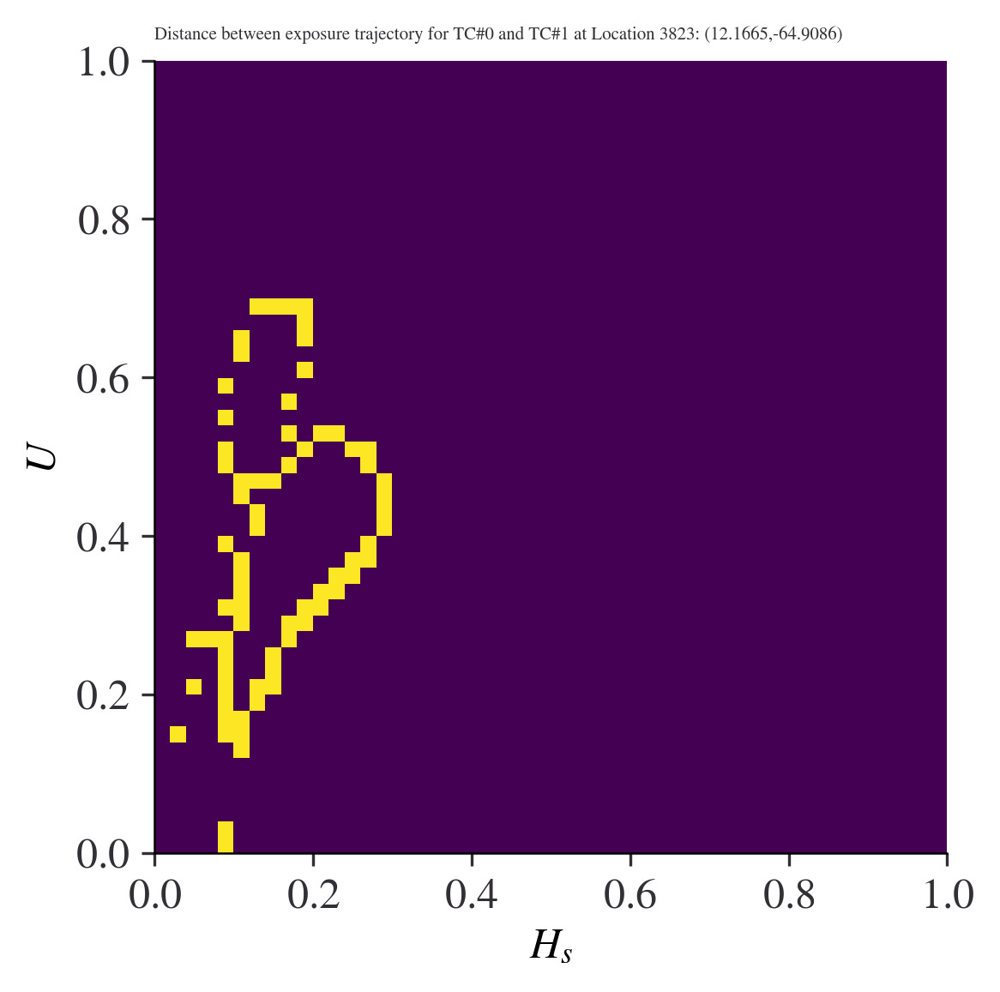

In [8]:
fig, ax = plt.subplots(1, 1, figsize=(4, 4))

ei = 0
ax.imshow(np.abs(exp_array[ei].T-exp_array[ei+1].T), origin="lower", extent=(0, 1, 0, 1))

ax.set_xlabel(var_name[0])
ax.set_ylabel(var_name[1])
ax.set_title(
    f"Distance between exposure trajectory for TC#{ei} and TC#{ei+1} at Location {pos}: ({mstme.latlon[pos,0]:.4f},{mstme.latlon[pos,1]:.4f})",
    size=5,
)

# All location, each TC

Text(0.0, 1.0, 'Exposure trajectory for TC#0 for all 100 locations')

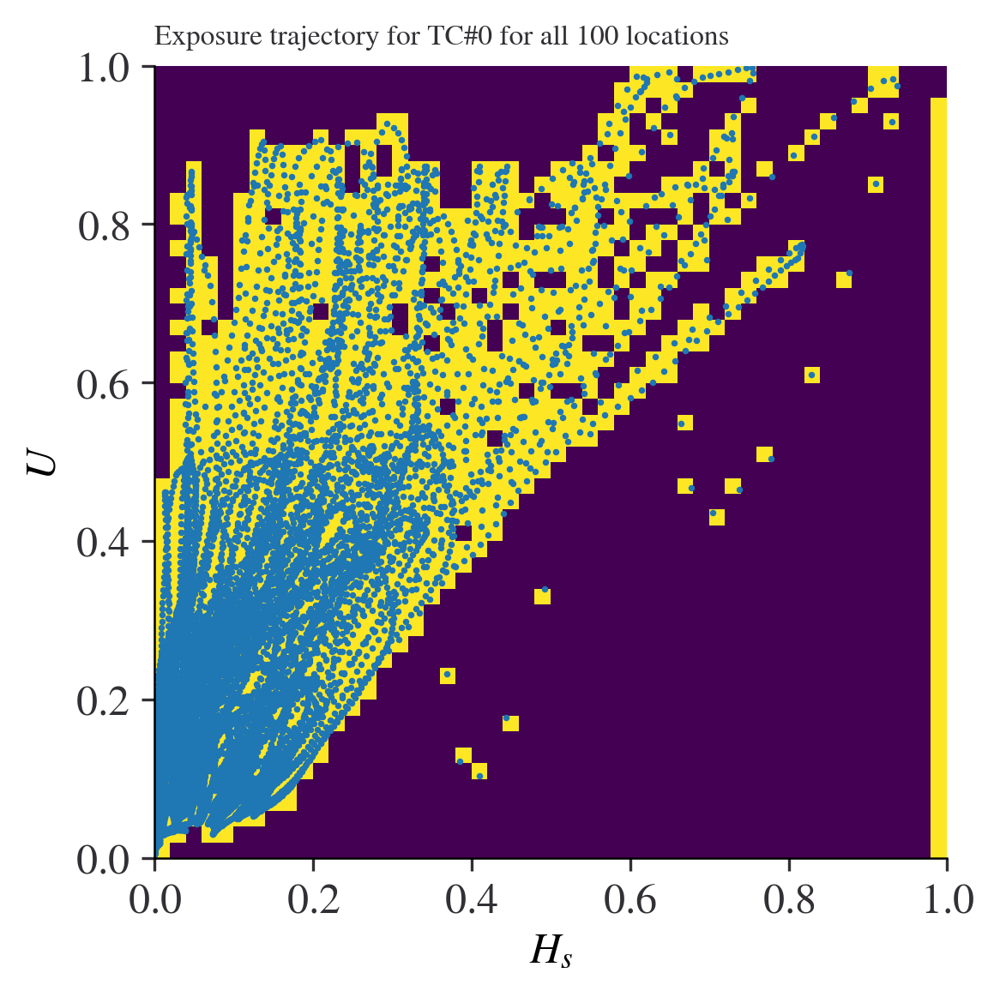

In [49]:
res = 50
dist_method = ["MD", "Hausdorff"]
di = 0

# [0,1]
_bins = np.linspace(0, 1, res, endpoint=False)

k_dict = {
  "k_null": [],
  "k": [],
}

vi = 0

num_events_ext = np.count_nonzero(mstme.is_e[vi])
stm_ext = mstme.stm[vi, mstme.is_e[vi]]
exp_series_ext = [exp_series[i] for i in np.where(mstme.is_e[vi])[0]]


exp_array = np.zeros((num_events_ext, res, res))
traj_all = []
for ei in range(num_events_ext):
  h_all = []
  u_all = []
  for pi, pos in enumerate(pos_list):
    # Quantize
    h = exp_series_ext[ei].isel(node=pos)["hs"].data
    u = exp_series_ext[ei].isel(node=pos)["UV_10m"].data
    h_all.extend(h.tolist())
    u_all.extend(u.tolist())
  # subtract 1 from digitize because 0.0~0.1 will return 1 and 0.9~1.0 will return res(and will cause indexerror)
  traj = np.array([h_all, u_all]).T
  traj_all.append(traj)
  _exp_digitized = np.digitize(traj, _bins) - 1
  _exp_digitized_unique = np.unique(_exp_digitized, axis=0)

  array = np.zeros((res, res))
  for cell in _exp_digitized_unique:
      try:
          array[cell[0], cell[1]] = 1
      except IndexError:
          print(ei, cell)
  exp_array[ei, :, :] = array

ei = 0
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
ax.imshow(exp_array[ei].T, origin="lower", extent=(0, 1, 0, 1))
ax.scatter(
    traj_all[ei][:,0],
    traj_all[ei][:,1],
    s=1,
)
ax.set_xlabel(var_name[0])
ax.set_ylabel(var_name[1])
ax.set_title(
    f"Exposure trajectory for TC#{ei} for all 100 locations",
    size=8,
)

In [43]:
_exp_digitized.shape

(157, 100, 2)

In [45]:
traj.shape

(157, 100, 2)

In [ ]:
res = 50
dist_method = ["MD", "Hausdorff"]
di = 0

# [0,1]
_bins = np.linspace(0, 1, res, endpoint=False)

k_dict = {
  "k_null": [],
  "k": [],
}

vi = 0

num_events_ext = np.count_nonzero(mstme.is_e[vi])
stm_ext = mstme.stm[vi, mstme.is_e[vi]]
exp_series_ext = [exp_series[i] for i in np.where(mstme.is_e[vi])[0]]

fig, ax = plt.subplots(1, 1, figsize=(4, 4))

exp_array = np.zeros((num_events_ext, len(pos_list) , res, res))
for pi, pos in enumerate(pos_list):
  # Quantize
  # fig_q, ax_q = plt.subplots(
  exp_unique = []
  for ei in range(num_events_ext):
      h = exp_series_ext[ei].isel(node=pos)["hs"].data
      u = exp_series_ext[ei].isel(node=pos)["UV_10m"].data
# subtract 1 from digitize because 0.0~0.1 will return 1 and 0.9~1.0 will return res(and will cause indexerror)
_exp_digitized = np.digitize(np.array([h, u]).T, _bins) - 1
_exp_digitized_unique = np.unique(_exp_digitized, axis=0)
exp_unique.append(_exp_digitized_unique)

array = np.zeros((res, res))
for cell in _exp_digitized_unique:
    try:
        array[cell[0], cell[1]] = 1
    except IndexError:
        print(ei, cell)
exp_array[ei, pi, :, :] = array


  ax.imshow(exp_array[ei].T, origin="lower", extent=(0, 1, 0, 1))
  ax.scatter(
      exp_series_ext[ei].isel(node=pos)["hs"],
      exp_series_ext[ei].isel(node=pos)["UV_10m"],
      s=1,
  )
  ax.set_xlabel(var_name[0])
  ax.set_ylabel(var_name[1])
  ax.set_title(
      f"Exposure trajectory for TC#{ei} at Location {pos}: ({mstme.latlon[pos,0]:.4f},{mstme.latlon[pos,1]:.4f})",
      size=8,
  )

False


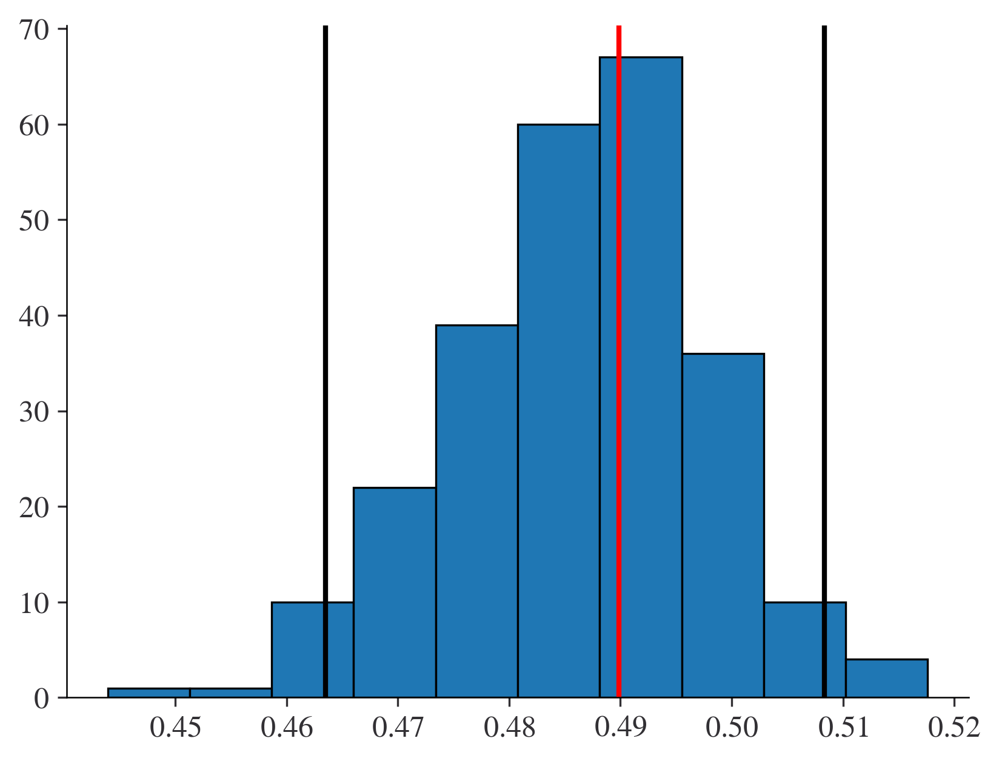

In [7]:
pi=6
vi=0

pct=np.percentile(k_dict['k_null'][pi][vi],[2.5,97.5])
plt.hist(k_dict['k_null'][pi][vi])
plt.axvline(k_dict['k'][pi][vi],c='red')
plt.axvline(pct[0],c='black')
plt.axvline(pct[1],c='black')
print(k_dict['k'][pi][vi] < pct[0] or pct[1] < k_dict['k'][pi][vi])

In [109]:
np.mean(k_dict_new['k_null'][pi][vi])

0.46237003745318356

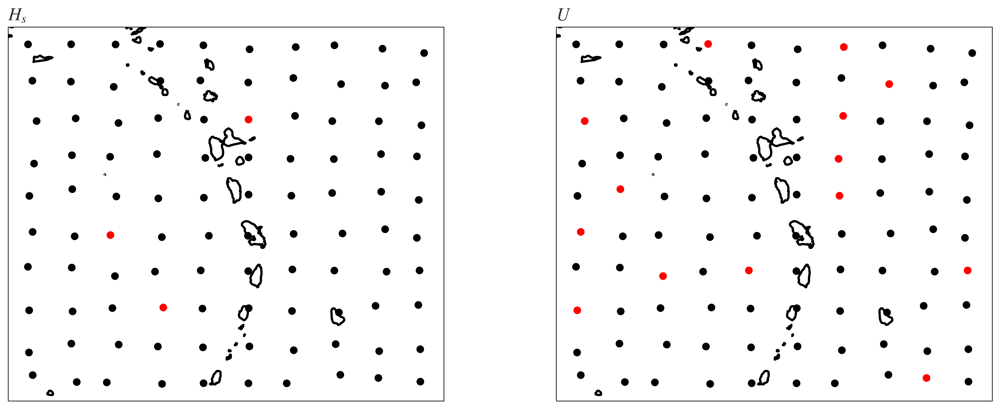

In [10]:
fig,ax=plt.subplots(1,num_vars,figsize=(8*2,6),subplot_kw={"projection": ccrs.PlateCarree()},)
for vi in range(num_vars):
  pval=[]
  for pi,pos in enumerate(pos_list):
  # print(pct[0],pct[1])
    _mean = np.mean(k_dict['k_null'][pi][vi])
    _ecdf = ECDF(k_dict['k_null'][pi][vi]-_mean)
    # pct = np.percentile(k_dict['k_null'][pi][vi],[2.5,97.5])
    _pval = 2*(1-_ecdf(np.abs(k_dict['k'][pi][vi]-_mean)))
    pval.append(_pval)
  _c = ["red" if p < 0.05 else "black" for p in pval]
  ax[vi].coastlines(lw=2)
  ax[vi].scatter(mstme.latlon[pos_list,1],mstme.latlon[pos_list,0],c=_c)
  ax[vi].set_title(f'{var_name[vi]}')

In [42]:
_exp_digitized.shape

(10, 253, 2)

In [40]:
exp_unique[0].shape

(10, 193, 2)

In [36]:
num=90
count=0
for i in range(num-2):
    for j in range(i+1,num-1):
        count +=1
print(count,
(num**2-num)//2-(num-1))

3916 3916


45

In [12]:
hoge = {}
for vi in range(2):
  hoge[f'distance{vi}']['k_all']=[vi,vi,vi]

KeyError: 'distance0'

In [11]:
hoge

{'distance0': {'k_all': [0, 0, 0]}, 'distance1': {'k_all': [1, 1, 1]}}

In [8]:
exp_unique[0].shape

(10, 97, 2)

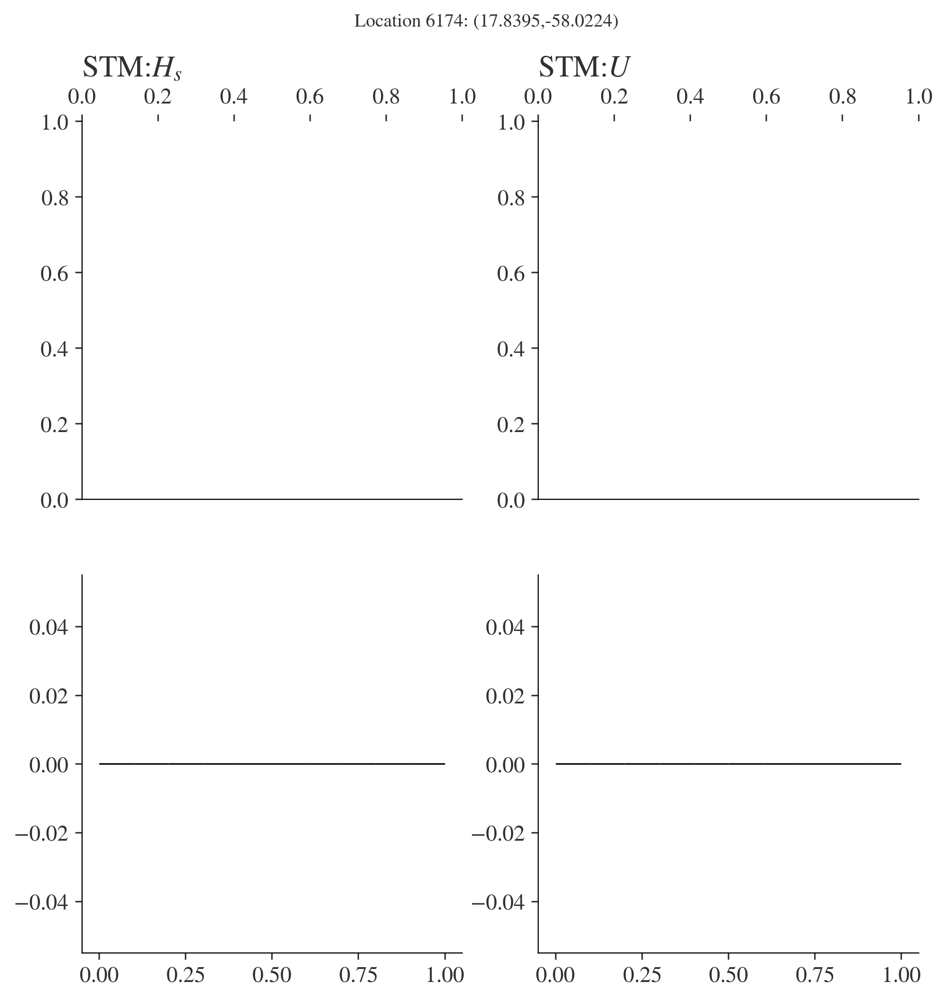

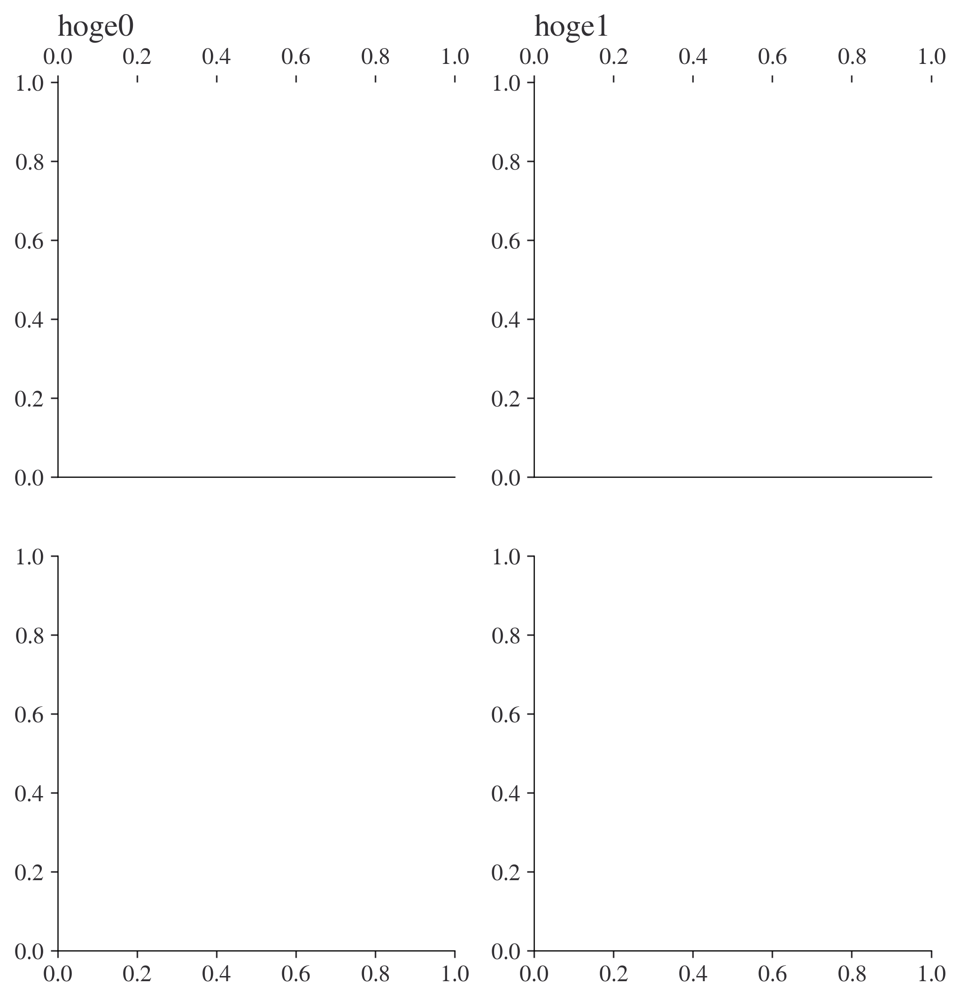

In [9]:
fig, ax = plt.subplots(2,num_vars,figsize=(4*num_vars,4*2),facecolor="white")
fig_h, ax_h = plt.subplots(2,num_vars,figsize=(4*num_vars,4*2),facecolor="white")
fig.suptitle(f'Location {pos}: ({mstme.latlon[pos,0]:.4f},{mstme.latlon[pos,1]:.4f})',size=10)
for vi in range(num_vars):
  ax[0,vi].set_title(f'STM:{var_name[vi]}')
  ax[0,vi].tick_params(top=True,labeltop=True, bottom=False, labelbottom=False)
  ax[1,vi].hist([])

  ax_h[0,vi].set_title(f'hoge{vi}')
  ax_h[0,vi].tick_params(top=True,labeltop=True, bottom=False, labelbottom=False)

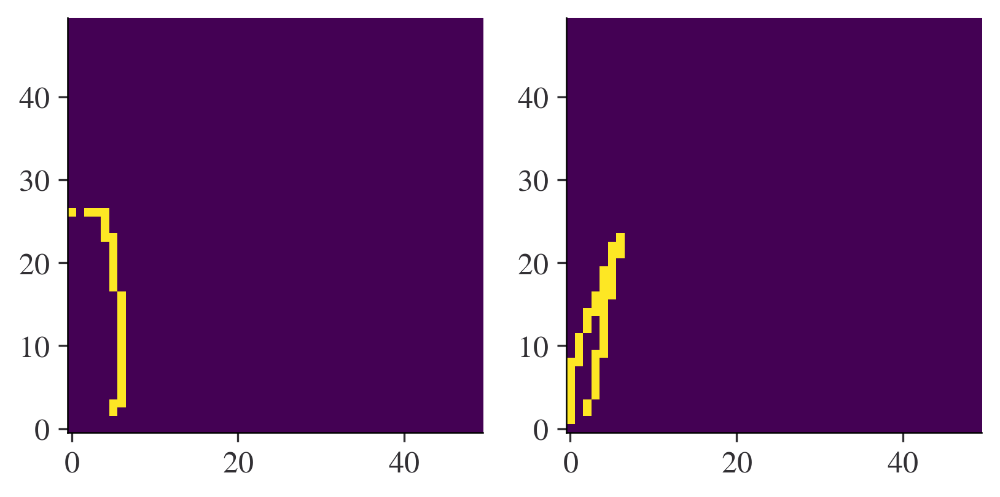

In [209]:
fig,ax=plt.subplots(1,2)

ax[0].imshow(exp_array[0].T,origin='lower')
ax[1].imshow(exp_array[1].T,origin='lower')

In [220]:
d_mat = np.empty((num_events,num_events))
d_mat_h = np.empty((num_events,num_events))
for i in range(num_events):
  for j in range(i,num_events):
    _d = euclidean_distances(exp_unique[i],exp_unique[j]).mean()
    _d_h, _, _ = directed_hausdorff(exp_unique[i],exp_unique[j])
    d_mat[i,j]=_d
    d_mat[j,i]=_d
    d_mat_h[i,j]=_d_h
    d_mat_h[j,i]=_d_h

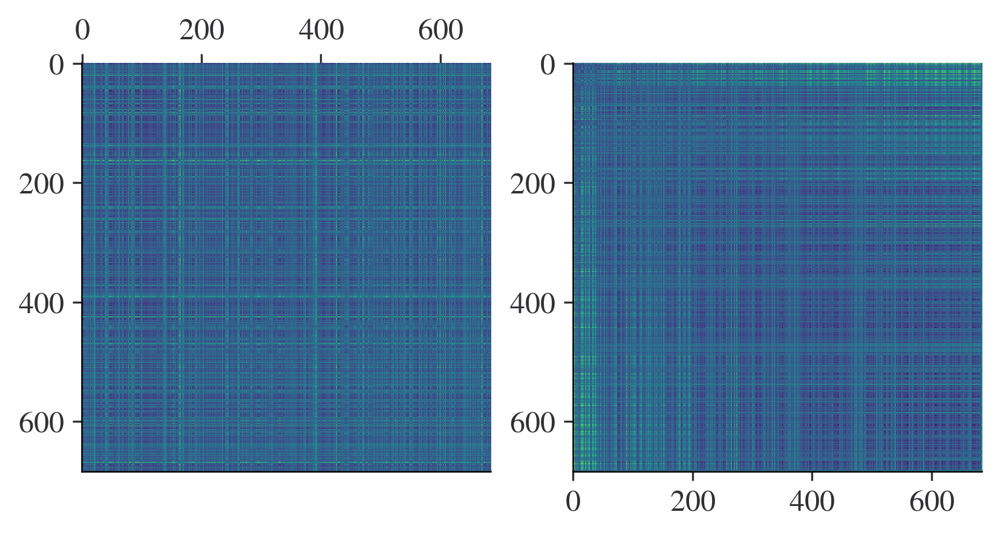

In [258]:
idx_list = stm.argsort()[1]
d_mat_sorted = d_mat[idx_list,:][:,idx_list]
d_mat_h_sorted = d_mat_h[idx_list,:][:,idx_list]
fig,ax=plt.subplots(1,2)
ax[0].imshow(d_mat)
ax[0].tick_params(top=True,labeltop=True, bottom=False, labelbottom=False)
ax[1].imshow(d_mat_sorted)
ax[1].tick_params(top=True,labeltop=True, bottom=False, labelbottom=False)

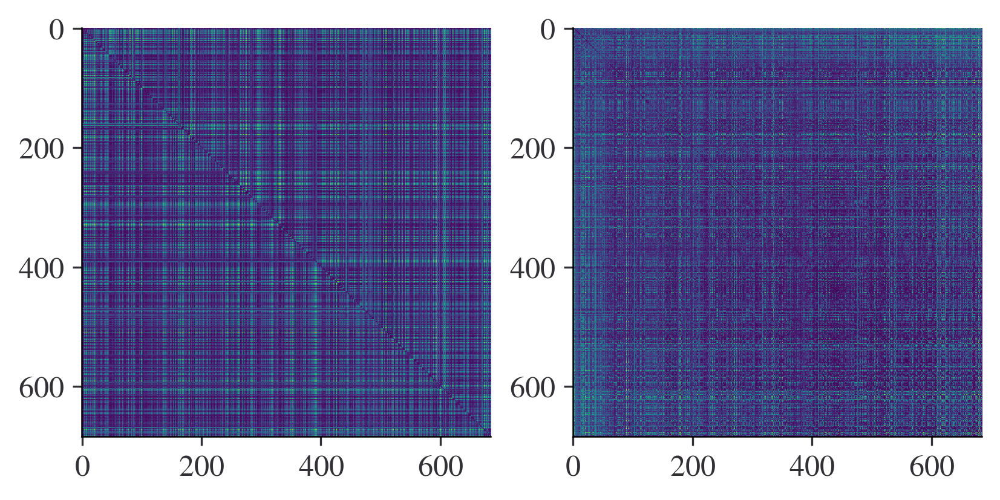

In [245]:
fig,ax=plt.subplots(1,2)
ax[0].imshow(d_mat_h)
ax[1].imshow(d_mat_h_sorted)

49.23% of SD increases as STM of H increases


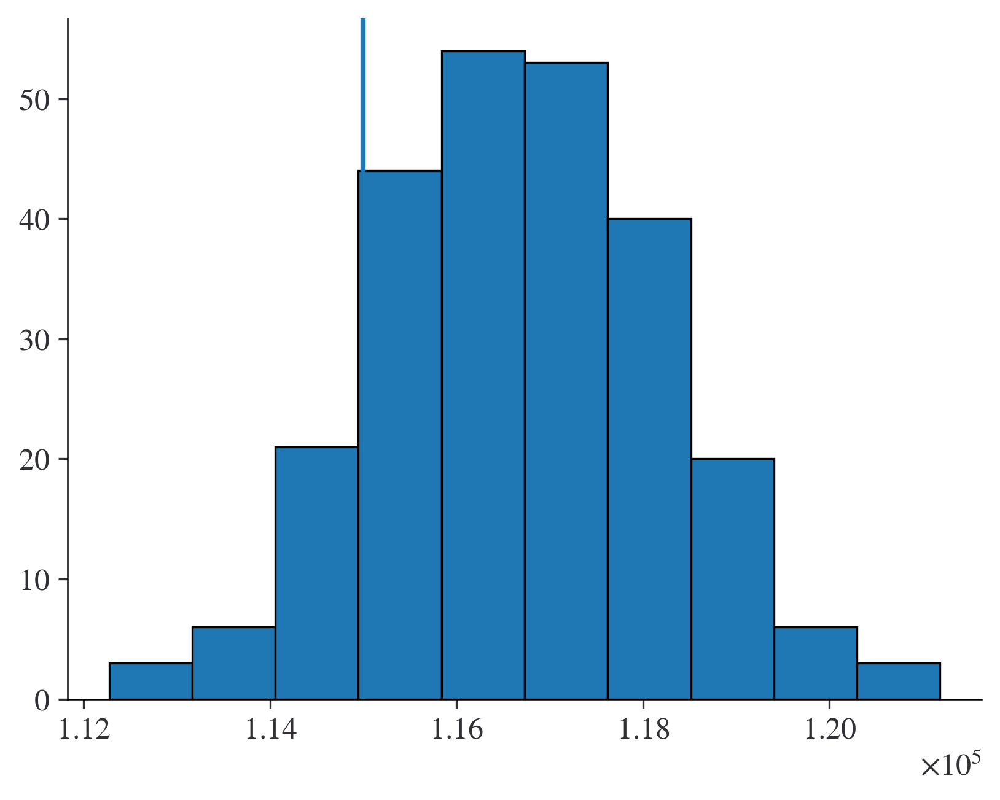

In [248]:
k = 0
count = 0
for i in range(num_events-2):
    for j in range(i+1,num_events-1):
        if d_mat_sorted[i,j]<d_mat_sorted[i,j+1]: k+=1
        count +=1
print(f'{k/count*100:.2f}% of SD increases as STM of H increases')

k_r = []
for ri in range(250):
  _idx_list=np.arange(num_events)
  np.random.shuffle(_idx_list)
  d_mat_sorted_random = d_mat[_idx_list,:][:,_idx_list]
  _k = 0
  for i in range(num_events-2):
      for j in range(i+1,num_events-1):
          if d_mat_sorted_random[i,j]<d_mat_sorted_random[i,j+1]: _k+=1
  k_r.append(_k)
plt.hist(k_r)
plt.axvline(k)

45.52% of SD increases as STM of H increases


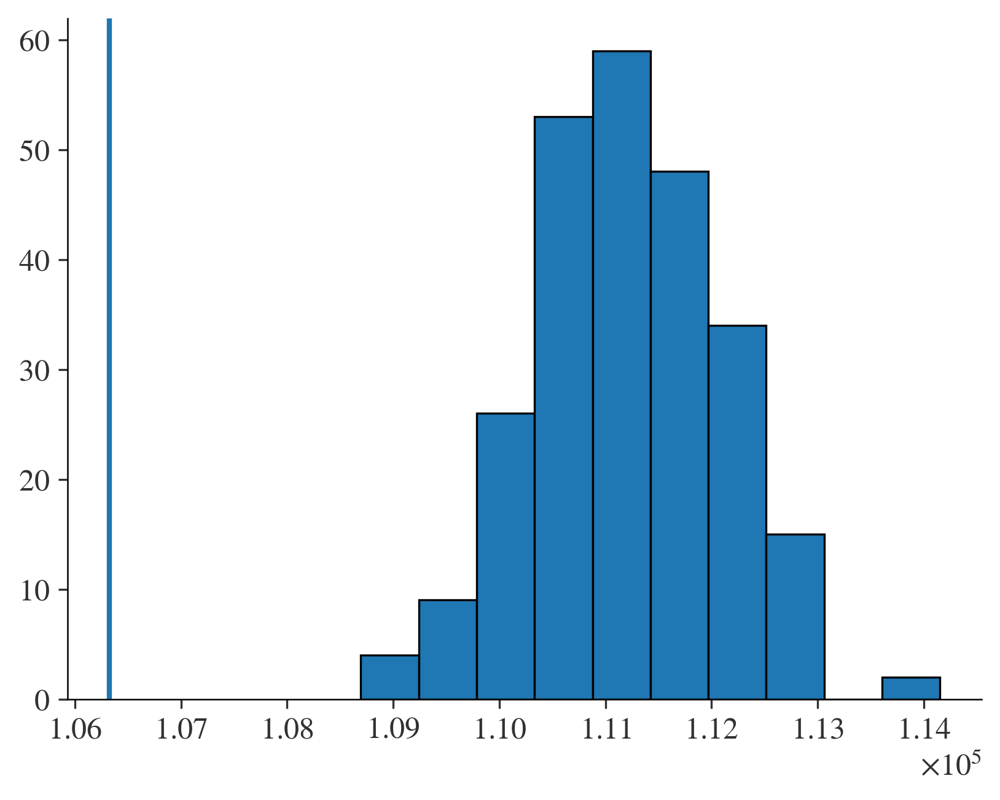

In [249]:
k = 0
count = 0
for i in range(num_events-2):
    for j in range(i+1,num_events-1):
        if d_mat_h_sorted[i,j]<d_mat_h_sorted[i,j+1]: k+=1
        count +=1
print(f'{k/count*100:.2f}% of SD increases as STM of H increases')

k_r = []
for ri in range(250):
  _idx_list=np.arange(num_events)
  np.random.shuffle(_idx_list)
  d_mat_h_sorted_random = d_mat_h[_idx_list,:][:,_idx_list]
  _k = 0
  for i in range(num_events-2):
      for j in range(i+1,num_events-1):
          if d_mat_h_sorted_random[i,j]<d_mat_h_sorted_random[i,j+1]: _k+=1
  k_r.append(_k)
plt.hist(k_r)
plt.axvline(k)

In [173]:
exp_unique = []
for mat in exp_array:
    exp_unique.append(np.argwhere(mat==1))

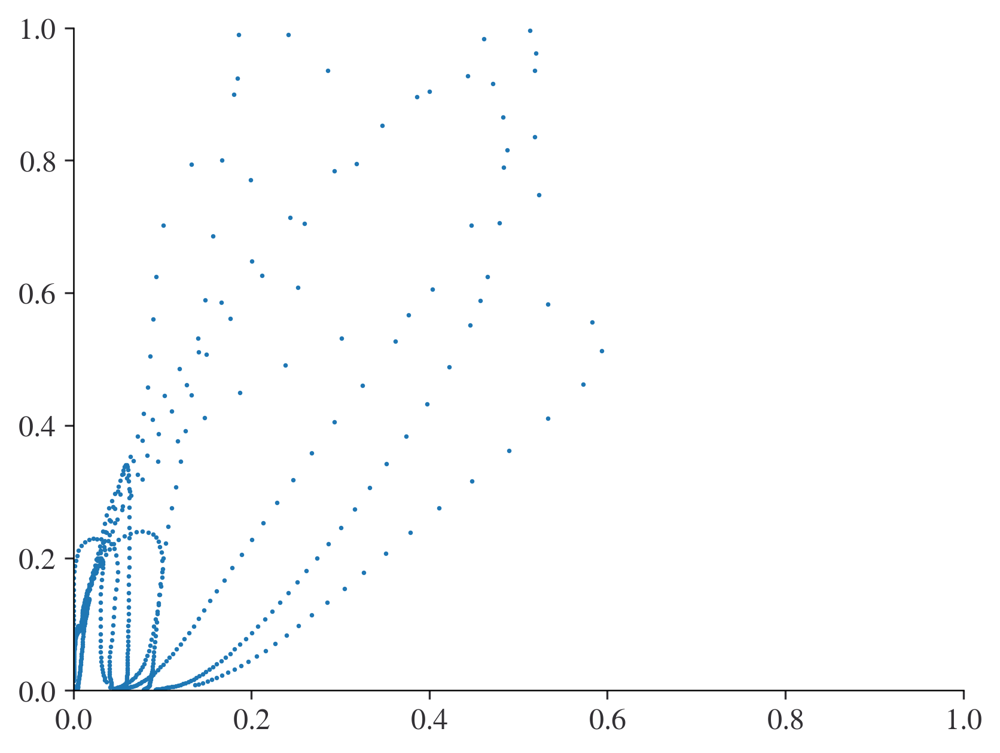

In [43]:
ei=622
h = exp_series[ei].isel(node=pos)['hs']
u = exp_series[ei].isel(node=pos)['UV_10m']
plt.scatter(h,u,s=1)
plt.xlim((0,1))
plt.ylim((0,1))
# _bins = np.linspace(0,1,res,endpoint=False)
# exp_digitized = np.digitize([h,u],_bins,right=True)
# subtract 1 from digitize because 0.0~0.1 will return 1 and 0.9~1.0 will return res(and will cause indexerror)
_exp_digitized = np.digitize(np.array([h,u]).T,_bins)-1
_exp_digitized_unique = np.unique(_exp_digitized,axis=0)

In [45]:
h

<xarray.DataArray 'hs' (time: 109, node: 10)>
array([[0.      , 0.      , 0.      , ..., 0.      , 0.      , 0.      ],
       [0.      , 0.      , 0.      , ..., 0.      , 0.      , 0.      ],
       [0.      , 0.      , 0.      , ..., 0.      , 0.      , 0.      ],
       ...,
       [0.080616, 0.042679, 0.145228, ..., 0.047421, 0.095436, 0.034973],
       [0.079431, 0.042087, 0.141079, ..., 0.046236, 0.093657, 0.035566],
       [0.078838, 0.041494, 0.136929, ..., 0.04505 , 0.092472, 0.037344]],
      dtype=float32)
Coordinates:
  * time       (time) datetime64[ns] 2000-06-01T18:00:00 ... 2000-06-04
    latitude   (node) float32 ...
    longitude  (node) float32 ...
Dimensions without coordinates: node

In [44]:

_exp_digitized.shape

(10, 109, 2)

In [159]:
_exp_digitized.argsort(axis=0)
_exp_digitized[54,:]
u[54]

<xarray.DataArray 'UV_10m' ()>
array(1., dtype=float32)
Coordinates:
    time       datetime64[ns] 2000-06-02T21:00:00
    latitude   float32 ...
    longitude  float32 ...

In [161]:
x = np.array([0.0, 0.05, 0.15, 0.25, 0.35, 0.45, 0.55, 0.65, 0.75, 0.85, 0.95, 1.0])
np.digitize(x,_bins,right=True)-1

array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8,  9,  9], dtype=int64)

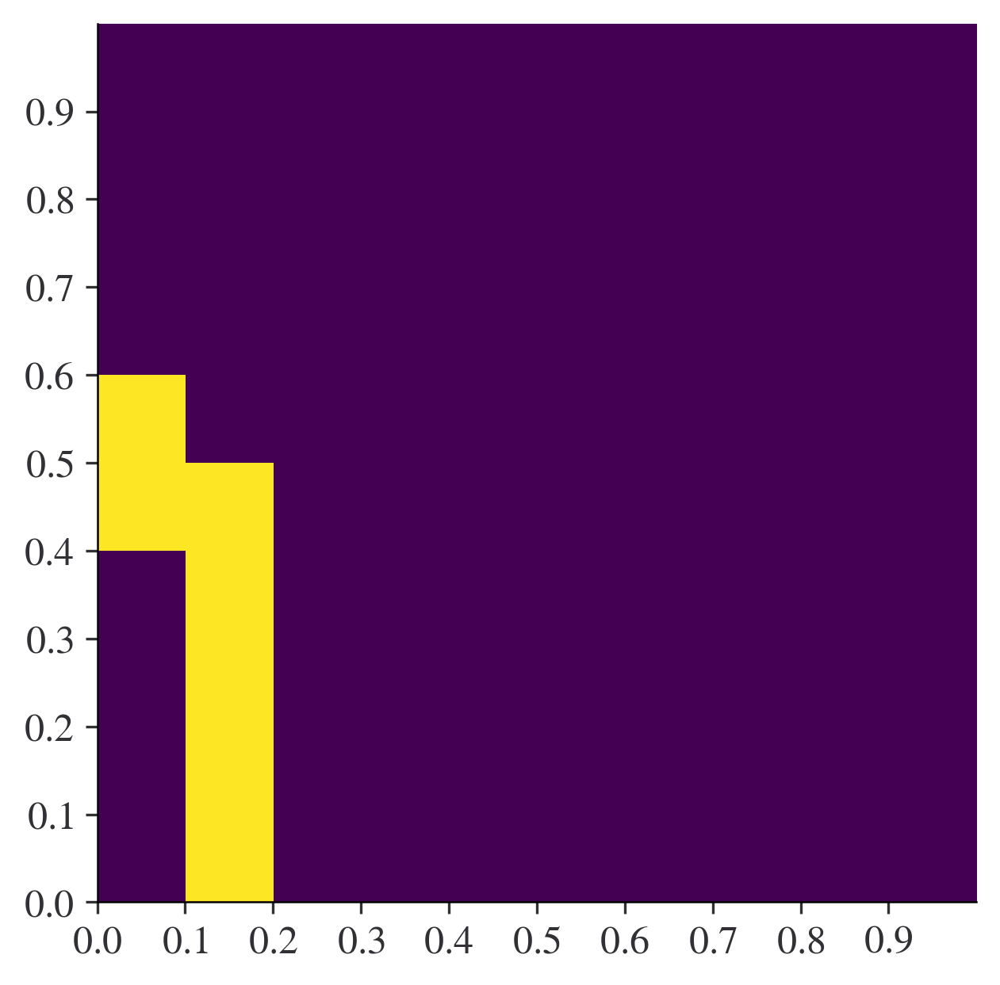

In [170]:
plt.imshow(exp_array[0].T,origin='lower',extent=(0,1,0,1))
xt=plt.xticks(_bins)
yt=plt.yticks(_bins)

In [119]:
cell = np.digitize([0.15,0.05],_bins,right=True)
cell
# print(_bins[cell[0]],_bins[cell[1]])

array([1, 0], dtype=int64)

In [29]:
np.digitize([[0, 0.2]],_bins,right=True)

array([[0, 1]], dtype=int64)

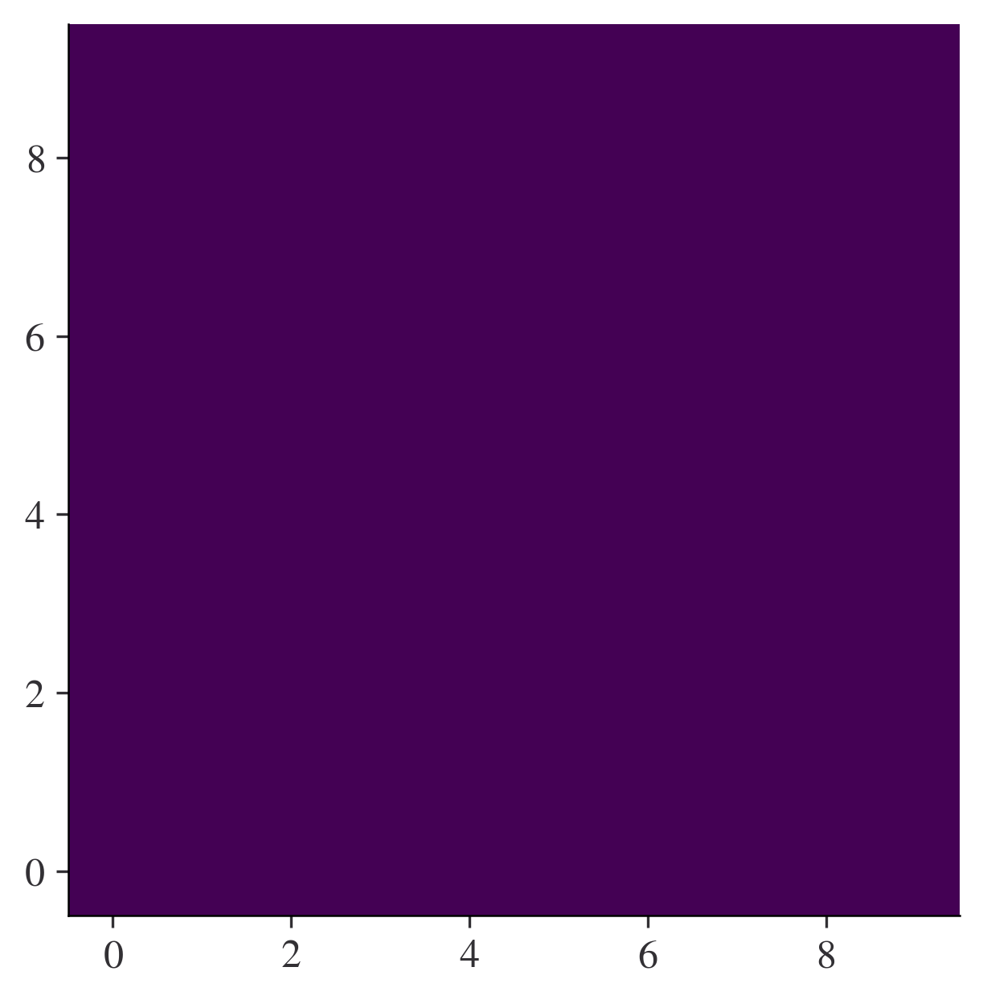

In [ ]:
fig,ax=plt.subplots(1,1)
rng = np.random.default_rng()
array = rng.choice([0,1],size=(10,10))
array = np.zeros((10,10))

ax.imshow(array,origin='lower')

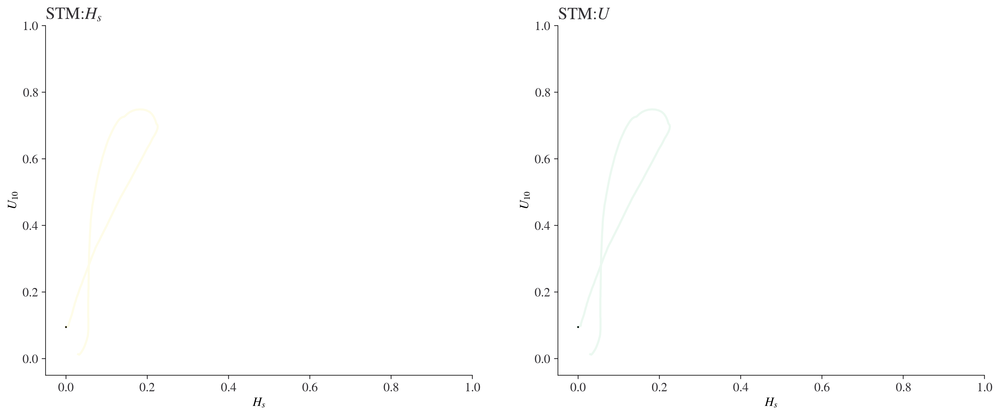

In [22]:
fig, ax = plt.subplots(
    1,
    2,
    figsize=(8 * 2, 6),
    facecolor="white",
  )
cmap = plt.get_cmap("viridis", 100)
pos = pos_list[0]
for vi in range(2):
  _ax = ax[vi]
  _ax.set_title(f'STM:{var_name[vi]}')
  _ax.set_xlim(-0.05,1)
  _ax.set_ylim(-0.05,1)
  _ax.set_xlabel('$H_s$')
  _ax.set_ylabel('$U_{10}$')
  stm_max = stm[vi].max().data
  i=371
  _ax.scatter(exp_series[i]['hs'][0,pos],exp_series[i]['UV_10m'][0,pos],s=1,color='black')
  _ax.plot(exp_series[i]['hs'][:,pos],exp_series[i]['UV_10m'][:,pos],alpha=0.1,c=cmap(stm[vi,i]/stm_max))


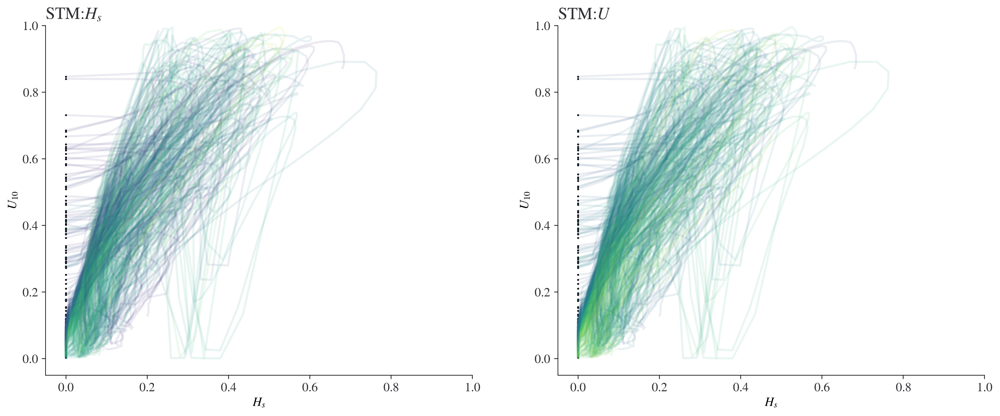

In [ ]:
fig, ax = plt.subplots(
    1,
    2,
    figsize=(8 * 2, 6),
    facecolor="white",
  )
cmap = plt.get_cmap("viridis", 100)

for vi in range(2):
  _ax = ax[vi]
  _ax.set_title(f'STM:{var_name[vi]}')
  _ax.set_xlim(-0.05,1)
  _ax.set_ylim(-0.05,1)
  _ax.set_xlabel('$H_s$')
  _ax.set_ylabel('$U_{10}$')
  stm_max = stm[vi].max().data
  for i in range(num_events):
    _ax.scatter(exp_series[i]['hs'][0,5735],exp_series[i]['UV_10m'][0,5735],s=1,color='black')
    _ax.plot(exp_series[i]['hs'][:,5735],exp_series[i]['UV_10m'][:,5735],alpha=0.1,c=cmap(stm[vi,i]/stm_max))


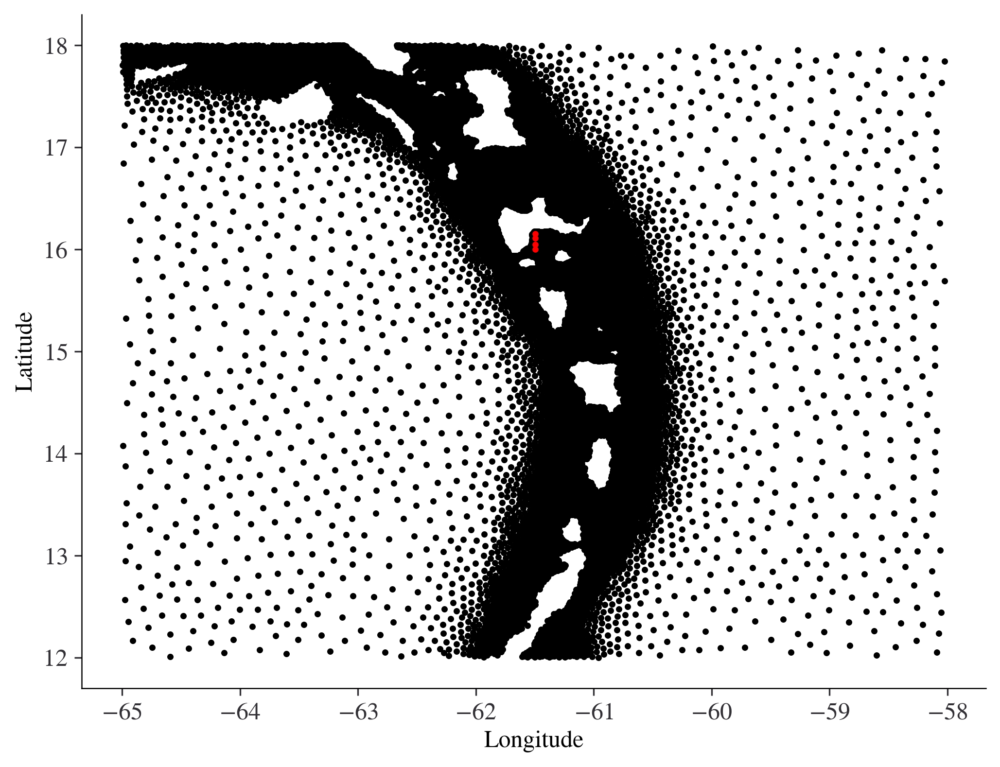

In [ ]:
fig, ax = plt.subplots(
    1,
    1,
    figsize=(8, 6),
    facecolor="white",
)

for vi in range(2):
  ax.set_xlabel("Longitude")
  ax.set_ylabel("Latitude")
  ax.scatter(
      cluster.latlon[:, 1],
      cluster.latlon[:, 0],
      s=5,
      c='black',
  )
for pos in pos_list:
    ax.scatter(
        cluster.latlon[pos, 1],
        cluster.latlon[pos, 0],
        s=5,
        c='red',
    )

In [ ]:
# 80th percentile (=CM threshold)
for vi in range(2):
  print(np.percentile(stm[vi].data,80))

14.361999702453614
43.72599792480469


$H_s$,14.36,16.09,24.20
$U$,43.72,47.50,63.97
$H_s$,14.36,16.09,24.20
$U$,43.72,47.50,63.97
$H_s$,14.36,16.09,24.20
$U$,43.72,47.50,63.97
$H_s$,14.36,16.09,24.20
$U$,43.72,47.50,63.97


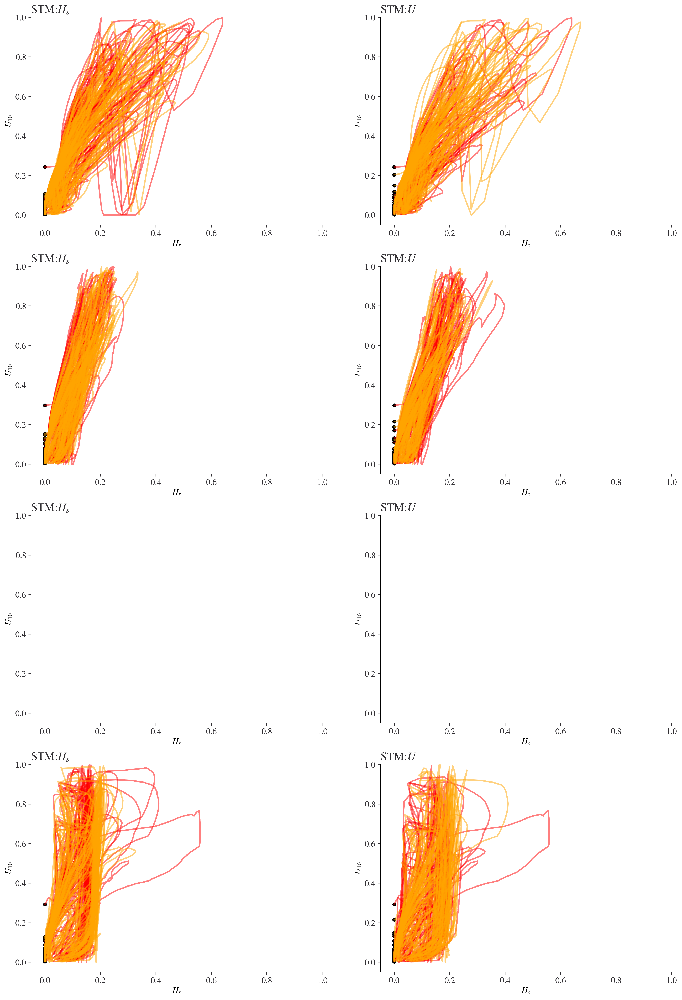

In [ ]:


fig, ax = plt.subplots(
    4,
    2,
    figsize=(8*2, 6 * 4),
    facecolor="white",
  )
cmap = plt.get_cmap("viridis", 100)
for pi,pos in enumerate(pos_list):
  thr2 = -138
  thr1 = thr2//2
  for vi in range(2):
    _ax = ax[pi,vi]
    _ax.set_title(f'STM:{var_name[vi]}')
    _ax.set_xlim(-0.05,1)
    _ax.set_ylim(-0.05,1)
    _ax.set_xlabel('$H_s$')
    _ax.set_ylabel('$U_{10}$')
    stm_max = stm[vi].max().data
    stm_argsort = stm[vi].values.argsort()
    for i,idx in enumerate(stm_argsort[thr1:]):
      _ax.scatter(exp_series[idx]['hs'][0,pos],exp_series[idx]['UV_10m'][0,pos],s=20,color='black')
      _ax.plot(exp_series[idx]['hs'][:,pos],exp_series[idx]['UV_10m'][:,pos],alpha=0.5,c='red',label='top half')
    for i,idx in enumerate(stm_argsort[thr2:thr1]):
      _ax.scatter(exp_series[idx]['hs'][0,pos],exp_series[idx]['UV_10m'][0,pos],s=20,color='black')
      _ax.plot(exp_series[idx]['hs'][:,pos],exp_series[idx]['UV_10m'][:,pos],alpha=0.5,c='orange',label='bottom half')
    print(f'{var_name[vi]},{stm[vi,stm_argsort[thr2]]:.2f},{stm[vi,stm_argsort[thr1]]:.2f},{stm[vi].max():.2f}')

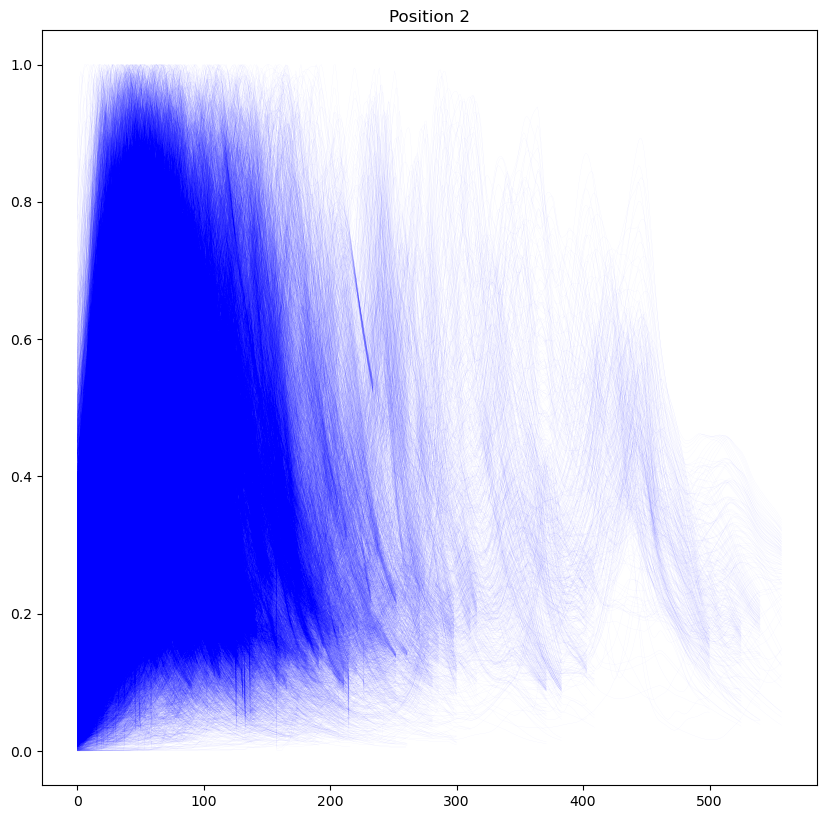

In [8]:
fig,ax=plt.subplots(figsize=(10,10),dpi=100,facecolor='white')
for pos in pos_list:
  
  for i in range(num_events):
  # i=2
    ax.plot(exp[i][0,:,pos], color = 'blue', lw=0.1, alpha=0.1)
    # ax.plot(exp[i][0,0,pos], exp[i][1,0,pos], color = 'black',s=0.5)
    # ax.scatter(exp[i][0,-1,pos], exp[i][1,-1,pos], color = 'red',s=0.5)
  # ax.set_xlim(0,1)
  # ax.set_ylim(0,1)
  # ax.set_aspect('equal')
  # ax.set_xlabel('$H_s$ Exposure')
  # ax.set_ylabel('$U_{10}$ Exposure')
  ax.set_title(f'Position {pos}')

Text(0.5, 1.0, 'Position 0')

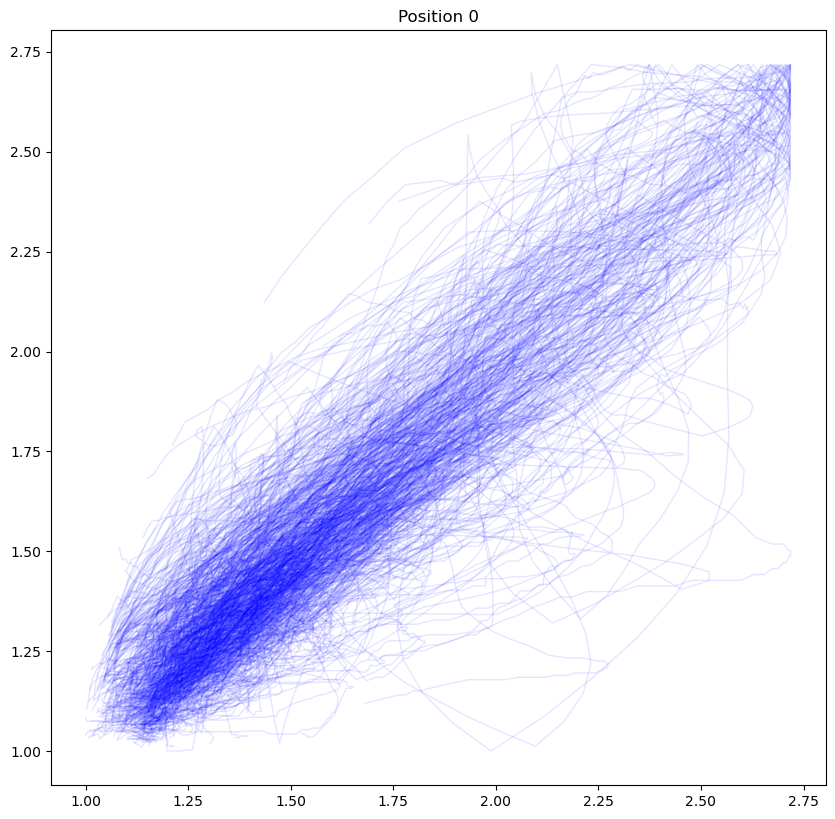

In [182]:
fig,ax=plt.subplots(figsize=(10,10),dpi=100,facecolor='white')

pos = 0  
for i in range(num_events):
  # if i!=5: continue
  ax.plot(np.exp(exp[i][0,:,pos]),np.exp(exp[i][1,:,pos]), color = 'blue', lw=1, alpha=0.1)
  # ax.plot(exp[i][0,:,pos], color = 'blue', lw=1, alpha=1)
  # ax.plot(exp[i][1,:,pos], color = 'red' , lw=1, alpha=1)
ax.set_title(f'Position {pos}')

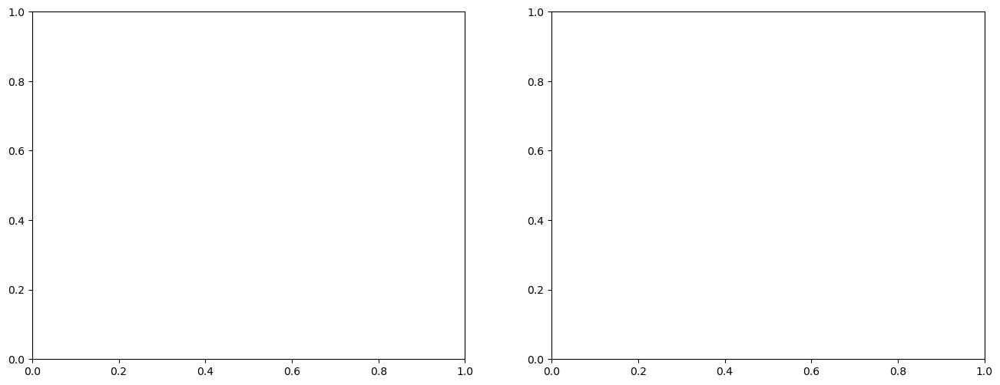

In [30]:
pos = 0
_e_peak = [[],[]]
_x_peak = [[],[]]
_idx = [[],[]]
_max = [[],[]]
_len = [[],[]]
_x = [[],[]]
# fig,ax=plt.subplots(1,2,figsize=(16,6),dpi=100,facecolor='white')

for vi in range(num_vars):
  for ei in range(num_events):
    _max[vi].append(exp[ei][vi,:,pos].max())
    _arg = exp[ei][vi,:,pos].argmax()
    _idx[vi].append(_arg)
    _x[vi].append(np.arange(exp[ei][vi,:,pos].shape[0]))
    _len[vi].append(min(20,min(_arg, len(exp[ei][vi,:,pos]))))
    _x_peak[vi].append(_x[vi][ei][_idx[vi][ei]-_len[vi][ei]:_idx[vi][ei]+_len[vi][ei]]-_idx[vi][ei])
    _e_peak[vi].append(exp[ei][vi,_idx[vi][ei]-_len[vi][ei]:_idx[vi][ei]+_len[vi][ei],pos])



# for vi in range(num_vars):
#   for ei in range(num_events):
#     ax[vi].plot(_x_peak,_e_peak/_max[vi][ei], color = 'blue', lw=0.1, alpha=0.3)

In [7]:
def gauss(x, H, sigma):
    return 1+(1-H)*(np.exp(-(x) ** 2 / (2 * sigma ** 2)))

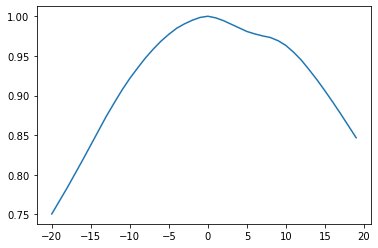

In [8]:
from scipy.optimize import curve_fit

popt = [[],[]]
pcov = [[],[]]
for vi in range(num_vars):
  for ei in range(num_events):
    _xx = _x[vi][ei][_idx[vi][ei]-_len[vi][ei]:_idx[vi][ei]+_len[vi][ei]] - _idx[vi][ei]
    _yy = exp[ei][vi,_idx[vi][ei]-_len[vi][ei]:_idx[vi][ei]+_len[vi][ei],pos]/_max[vi][ei]
    if len(_xx)>0 and len(_yy)>0:
      _popt, _pcov = curve_fit(gauss, _xx, _yy,bounds=([0,0],[1,100]), maxfev=1000)
    if ei==0 and vi==0:
      plt.plot(_xx,_yy)
    popt[vi].append(_popt)
    pcov[vi].append(_pcov)

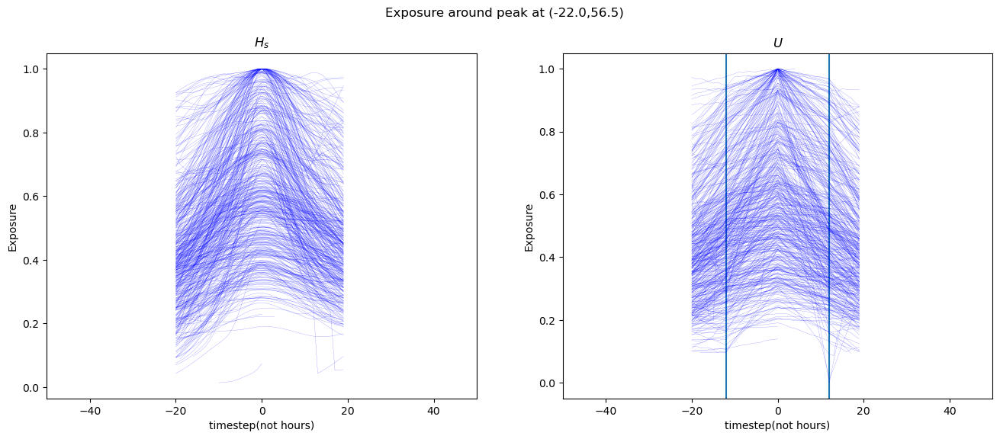

In [10]:
fig,ax=plt.subplots(1,2,figsize=(16,6),dpi=100,facecolor='white')
fig.suptitle(f'Exposure around peak at ({latlon[pos,0]},{latlon[pos,1]})')
ax[1].axvline(-12)
ax[1].axvline(12)
for vi in range(num_vars):
  ax[vi].set_xlim(-50,50)
  ax[vi].set_title(f'{var_name[vi]}')
  ax[vi].set_xlabel('timestep(not hours)')
  ax[vi].set_ylabel('Exposure')
  centers = np.linspace(-50,50,200)
  for ei in range(num_events):
    # ax[vi].plot(centers,gauss(centers,*popt[vi,ei]), color = 'orange', lw=0.1, alpha=1)
    ax[vi].plot(_x[vi][ei][_idx[vi][ei]-_len[vi][ei]:_idx[vi][ei]+_len[vi][ei]]-_idx[vi][ei],exp[ei][vi,_idx[vi][ei]-_len[vi][ei]:_idx[vi][ei]+_len[vi][ei],pos], color = 'blue', lw=0.1, alpha=1)

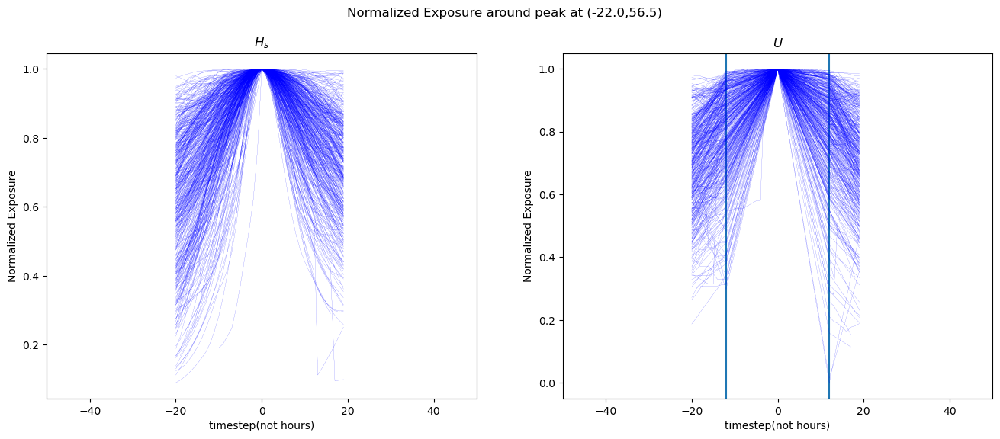

In [11]:
fig,ax=plt.subplots(1,2,figsize=(16,6),dpi=100,facecolor='white')
fig.suptitle(f'Normalized Exposure around peak at ({latlon[pos,0]},{latlon[pos,1]})')

ax[1].axvline(-12)
ax[1].axvline(12)
for vi in range(num_vars):
  ax[vi].set_xlim(-50,50)
  ax[vi].set_title(f'{var_name[vi]}')
  ax[vi].set_xlabel('timestep(not hours)')
  ax[vi].set_ylabel('Normalized Exposure')
  centers = np.linspace(-50,50,200)
  for ei in range(num_events):
    # ax[vi].plot(centers,gauss(centers,*popt[vi,ei]), color = 'orange', lw=0.1, alpha=1)
    ax[vi].plot(_x[vi][ei][_idx[vi][ei]-_len[vi][ei]:_idx[vi][ei]+_len[vi][ei]]-_idx[vi][ei],exp[ei][vi,_idx[vi][ei]-_len[vi][ei]:_idx[vi][ei]+_len[vi][ei],pos]/_max[vi][ei], color = 'blue', lw=0.1, alpha=1)

0.13417190775681342
1.0
0.4171907756813417
1.0
0.6813417190775681
2.0
1.471698113207547
2.0
2.3060796645702304
2.0
-0.014675052410901468
1.0
-0.570230607966457
1.0
0.6058700209643606
2.0
-0.6184486373165619
1.0
-0.6645702306079665
1.0
0.03563941299790356
1.0
0.689727463312369
1.0
1.530398322851153
2.0
1.480083857442348
2.0
3.3668763102725365
2.0
1.1320754716981132
1.0
0.16981132075471697
1.0
0.10272536687631027
1.0
-0.04612159329140461
1.0
-1.1425576519916143
1.0
1.0272536687631026
1.0


C:\Users\ksksn\AppData\Local\Temp/ipykernel_7324/130970004.py:20: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax=plt.subplots(figsize=(8,6),dpi=100,facecolor='white')


1.3962264150943395
2.0
1.4150943396226414
2.0
2.769392033542977
2.0
3.819706498951782
2.0
3.3752620545073375
2.0
-0.19916142557651992
1.0
-0.1761006289308176
1.0
-0.350104821802935
1.0
0.23270440251572327
1.0
0.6205450733752621
1.0
1.4444444444444444
2.0
2.0733752620545074
2.0
3.7672955974842766
2.0
5.073375262054507
2.0
5.989517819706499
2.0
-0.6645702306079665
1.0
-1.421383647798742
1.0
-0.4088050314465409
1.0
0.44025157232704404
1.0
-0.12368972746331237
1.0
1.1530398322851152
1.0
3.339622641509434
2.0
5.115303983228512
2.0
11.80293501048218
5.0
13.79245283018868
7.0
-4.362683438155137
0.0
-2.846960167714885
0.0
-2.052410901467505
1.0
-0.33752620545073375
1.0
-0.20754716981132076
1.0
-0.06708595387840671
1.0
0.7651991614255765
2.0
5.39412997903564
3.0
15.59119496855346
9.0
-7.721174004192872
-2.0
-5.1257861635220126
-2.0
-3.308176100628931
0.0
-1.8888888888888888
1.0
-0.7735849056603774
1.0
-1.1886792452830188
1.0
-0.8637316561844863
1.0
-0.8909853249475891
1.0
2.4171907756813416
3.0

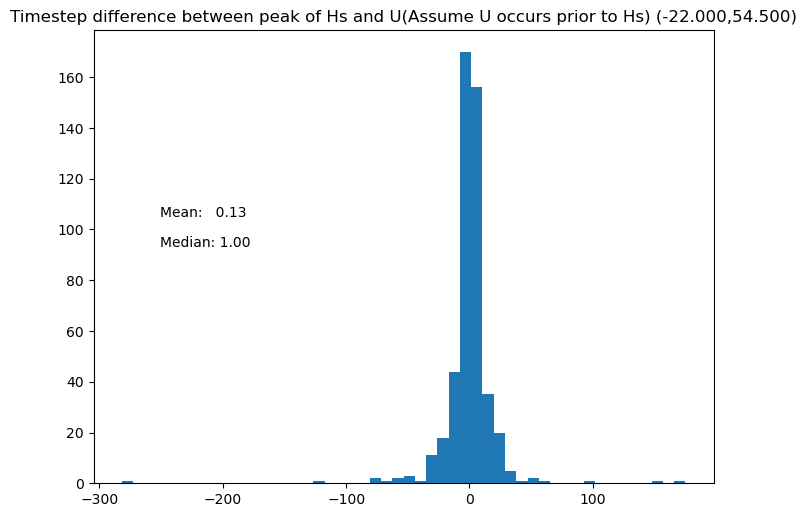

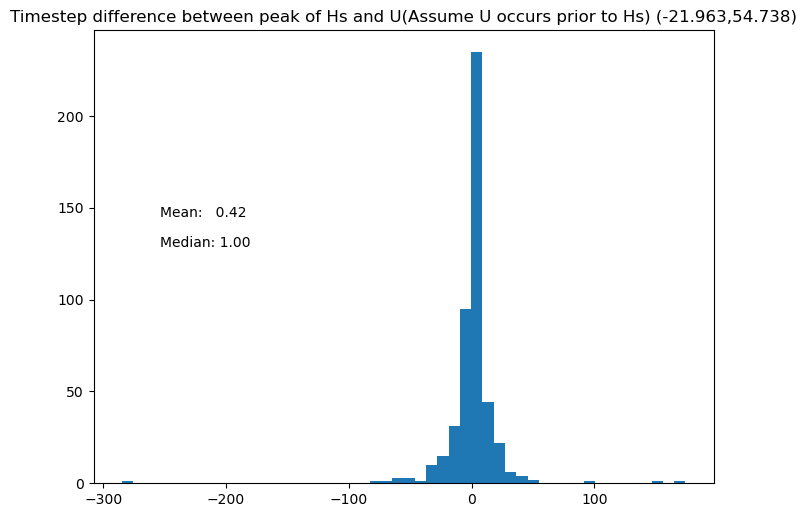

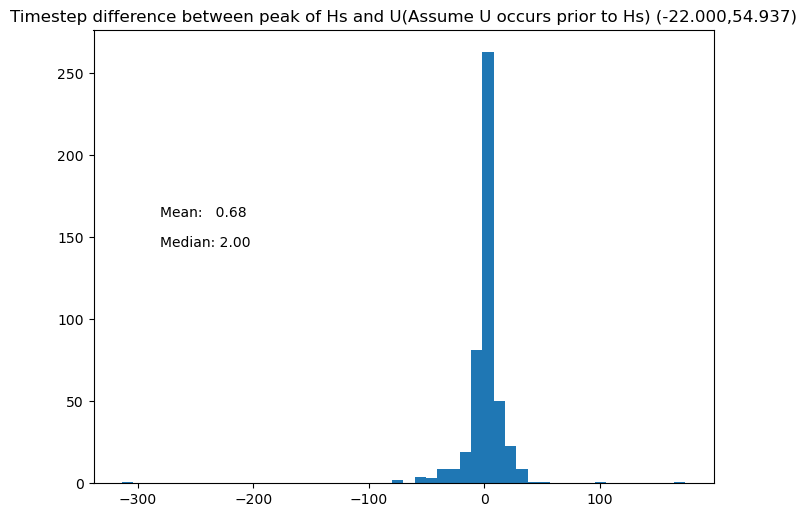

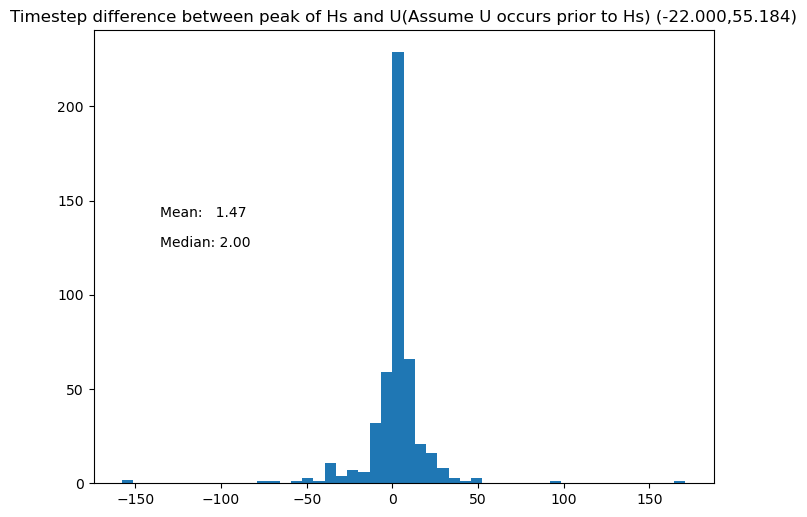

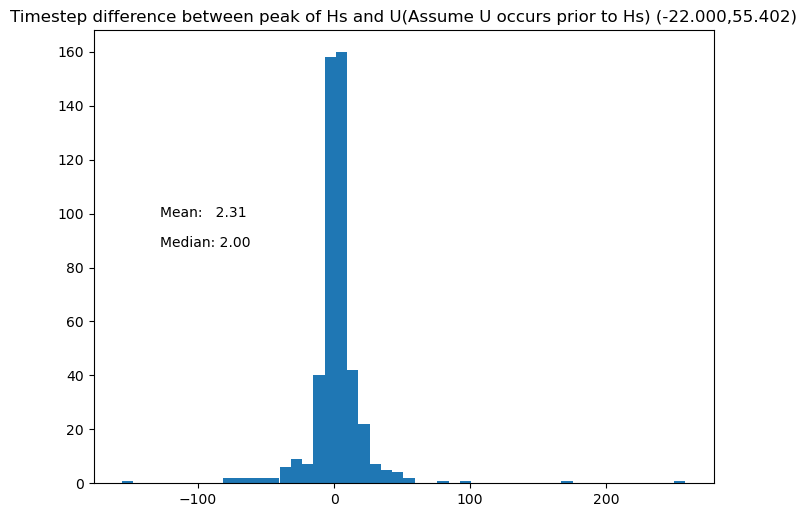

...

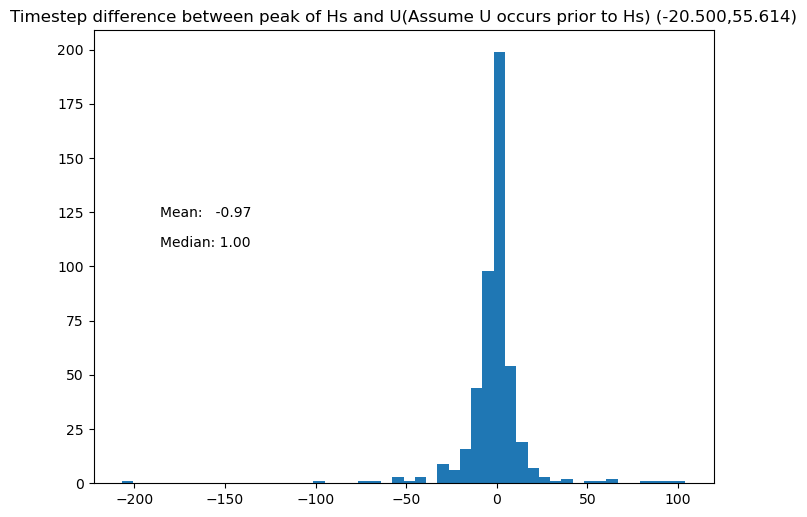

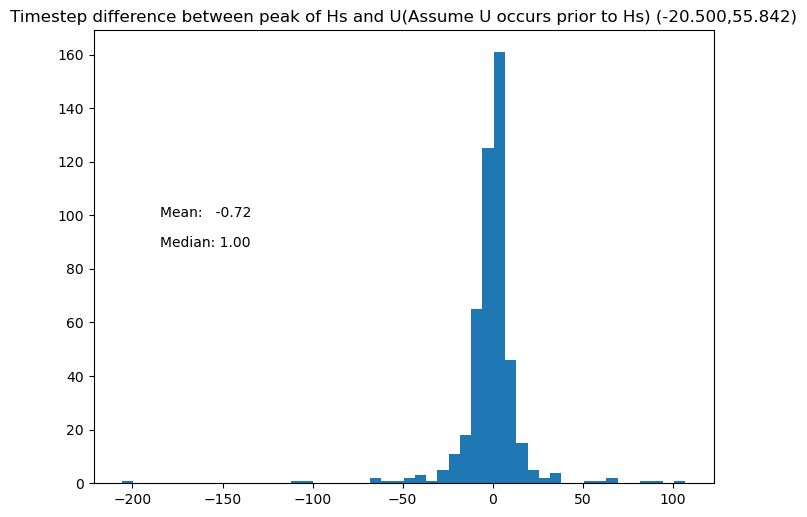

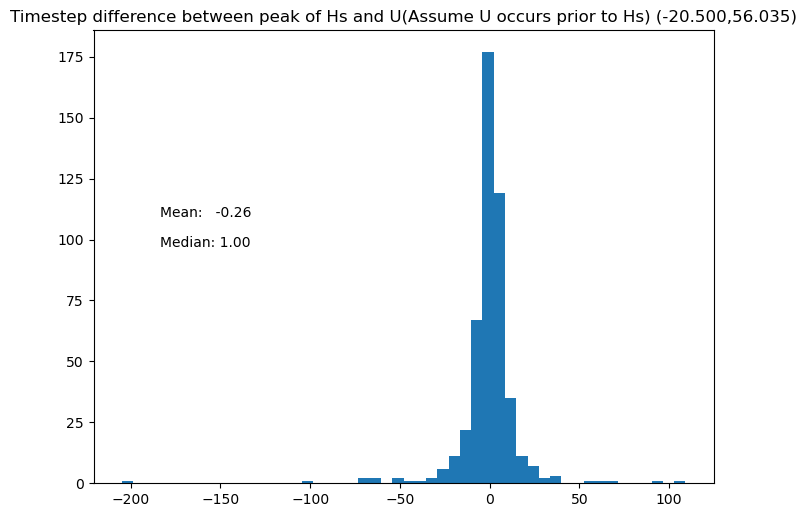

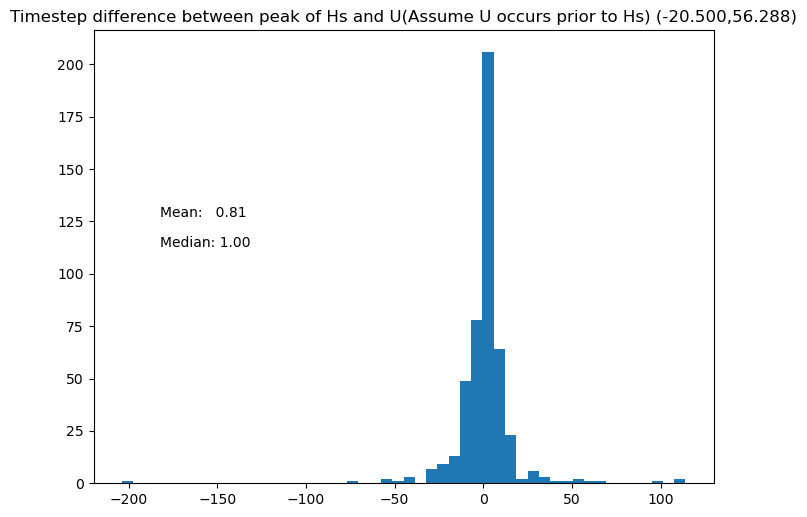

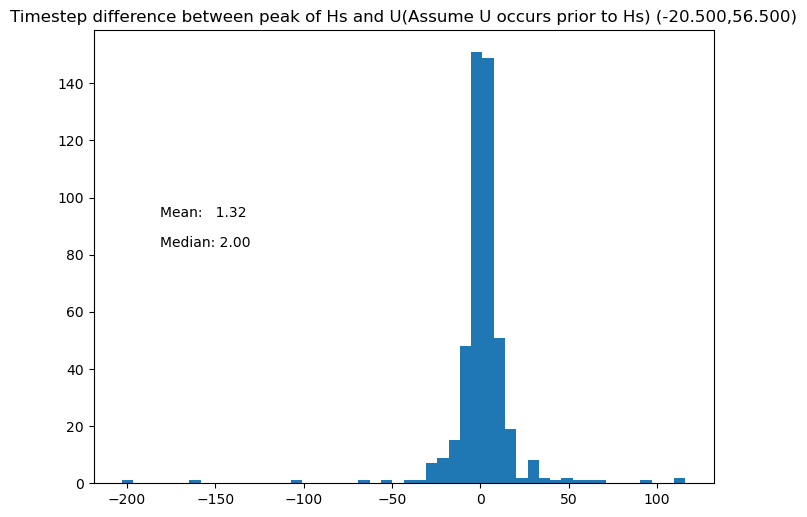

In [33]:
means = []
medians = []
for pos in pos_list:
  _idx = [[],[]]

  for vi in range(num_vars):
    for ei in range(num_events):
      _arg = exp[ei][vi,:,pos].argmax()
      _idx[vi].append(_arg)

  _idx_diff = []
  for ei in range(num_events):
    _idx_diff.append(_idx[0][ei]-_idx[1][ei])
  _idx_diff = np.array(_idx_diff)
  print(np.mean(_idx_diff))
  print(np.median(_idx_diff))
  means.append(np.mean(_idx_diff))
  medians.append(np.median(_idx_diff))

  fig,ax=plt.subplots(figsize=(8,6),dpi=100,facecolor='white')
  ax.set_title(f'Timestep difference between peak of Hs and U(Assume U occurs prior to Hs) ({latlon[pos,0]:.3f},{latlon[pos,1]:.3f})')
  ax.annotate(f'Mean:   {np.mean(_idx_diff):.2f}',[0.2,0.5],xycoords='figure fraction')
  ax.annotate(f'Median: {np.median(_idx_diff):.2f}',[0.2,0.45],xycoords='figure fraction')
  ax.hist(_idx_diff,bins=50)
  plt.savefig(f"./output/exposure_test/({latlon[pos,0]:.3f},{latlon[pos,1]:.3f}_Pos{pos}_peak_diff.png", bbox_inches="tight")



(array([ 2.,  5., 28., 49.,  9.,  4.,  0.,  0.,  1.,  2.]),
 array([-7.78825996, -5.45031447, -3.11236897, -0.77442348,  1.56352201,
         3.90146751,  6.239413  ,  8.57735849, 10.91530398, 13.25324948,
        15.59119497]),
 <BarContainer object of 10 artists>)

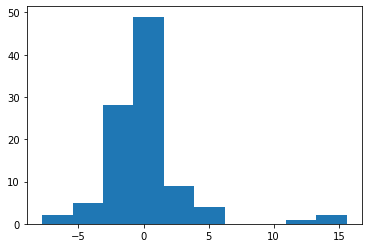

In [36]:
plt.hist(means)

FileNotFoundError: [Errno 2] No such file or directory: './output/exposure_test/(-22.000,54.500_Pos3.png'

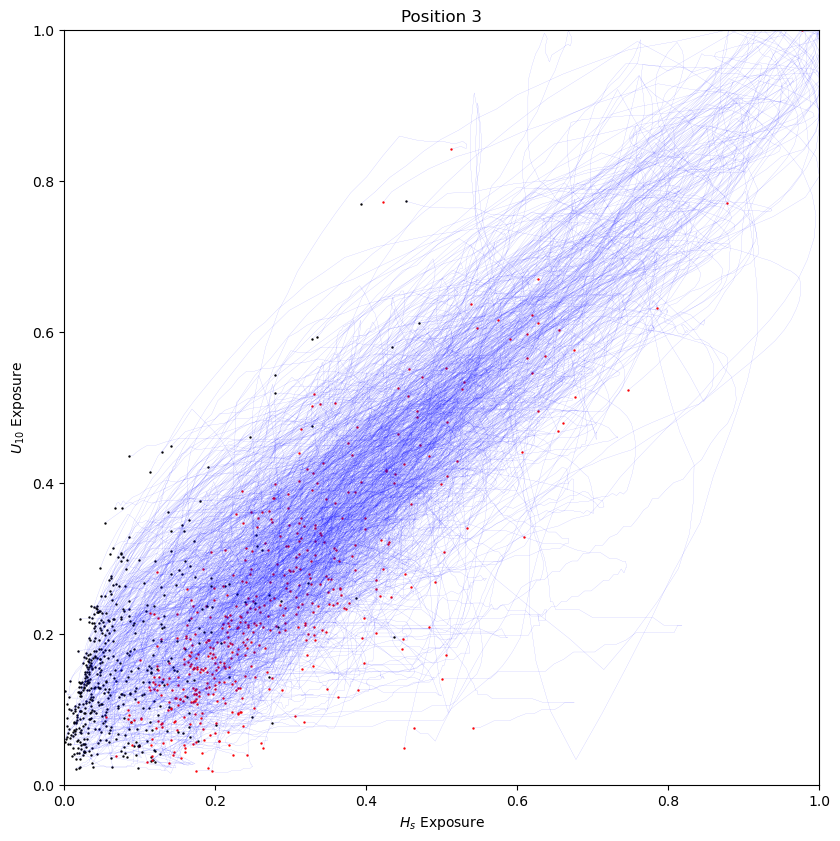

In [10]:
for pos in pos_list:
  fig,ax=plt.subplots(figsize=(10,10),dpi=100,facecolor='white')
  for i in range(num_events):
    ax.plot(exp[i][0,:,pos], exp[i][1,:,pos], color = 'blue', lw=0.1, alpha=0.5)
    ax.scatter(exp[i][0,0,pos], exp[i][1,0,pos], color = 'black',s=0.5)
    ax.scatter(exp[i][0,-1,pos], exp[i][1,-1,pos], color = 'red',s=0.5)
  ax.set_xlim(0,1)
  ax.set_ylim(0,1)
  ax.set_aspect('equal')
  ax.set_xlabel('$H_s$ Exposure')
  ax.set_ylabel('$U_{10}$ Exposure')
  ax.set_title(f'Position {pos}')
  # plt.savefig(f"./output/exposure_test/({latlon[pos,0]:.3f},{latlon[pos,1]:.3f}_Pos{pos}.png", bbox_inches="tight")
  

C:\Users\Kosuke\AppData\Local\Temp/ipykernel_12088/1780247187.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax=plt.subplots(figsize=(10,10),dpi=100,facecolor='white')


KeyboardInterrupt: 

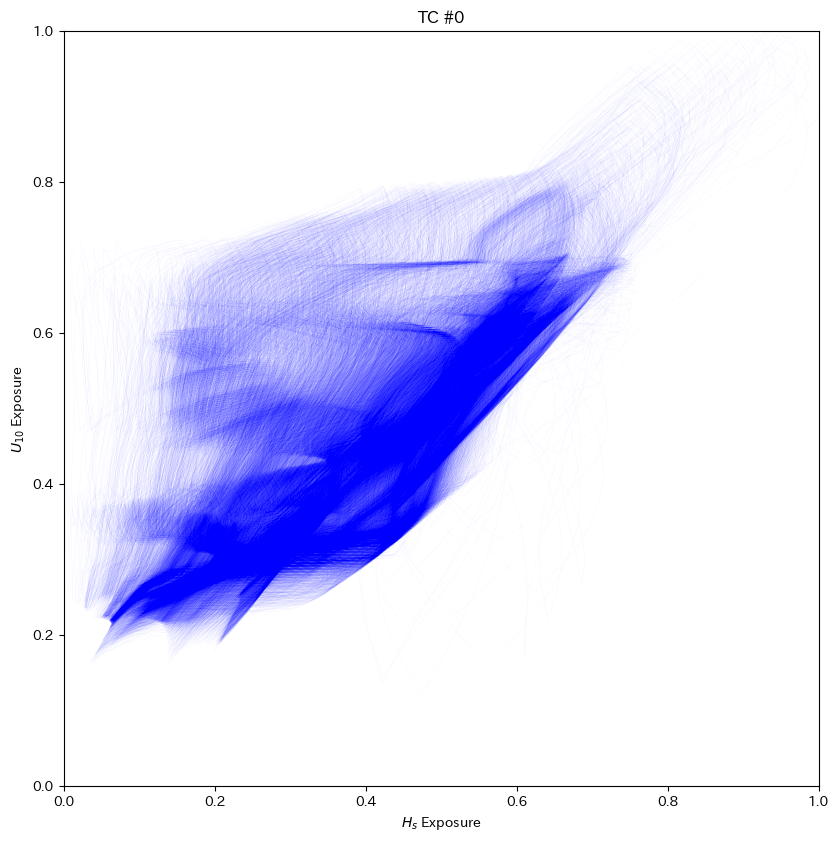

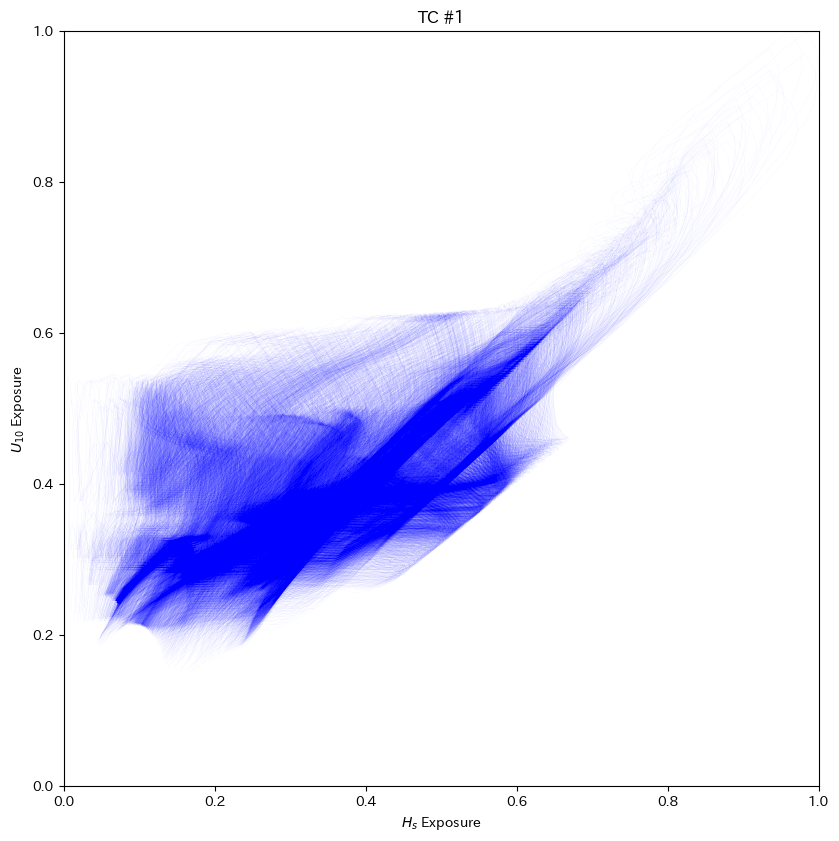

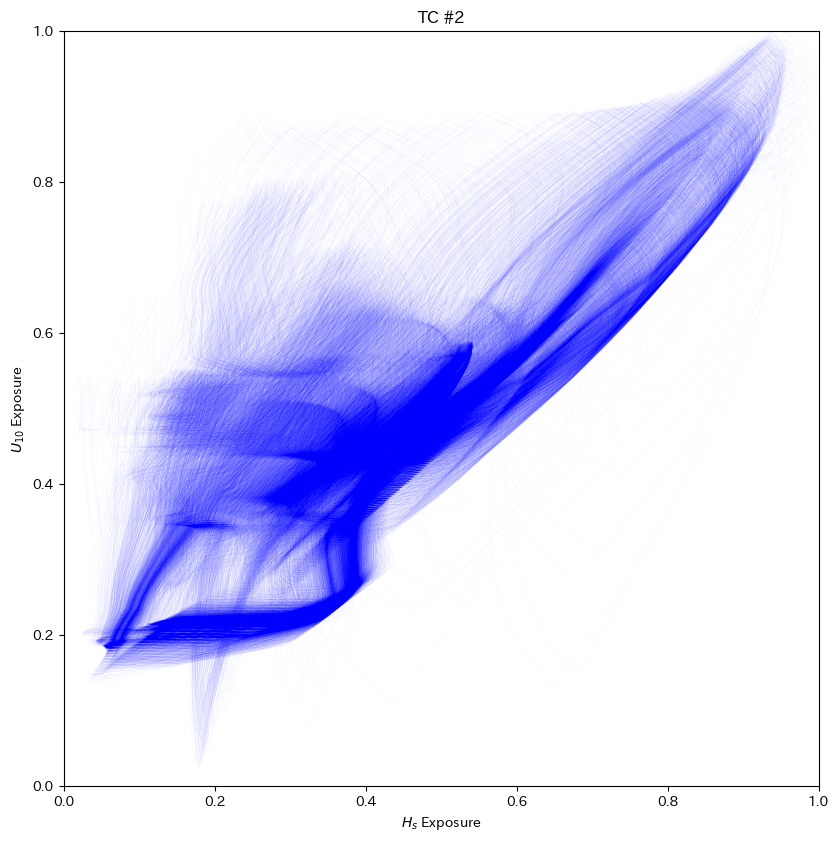

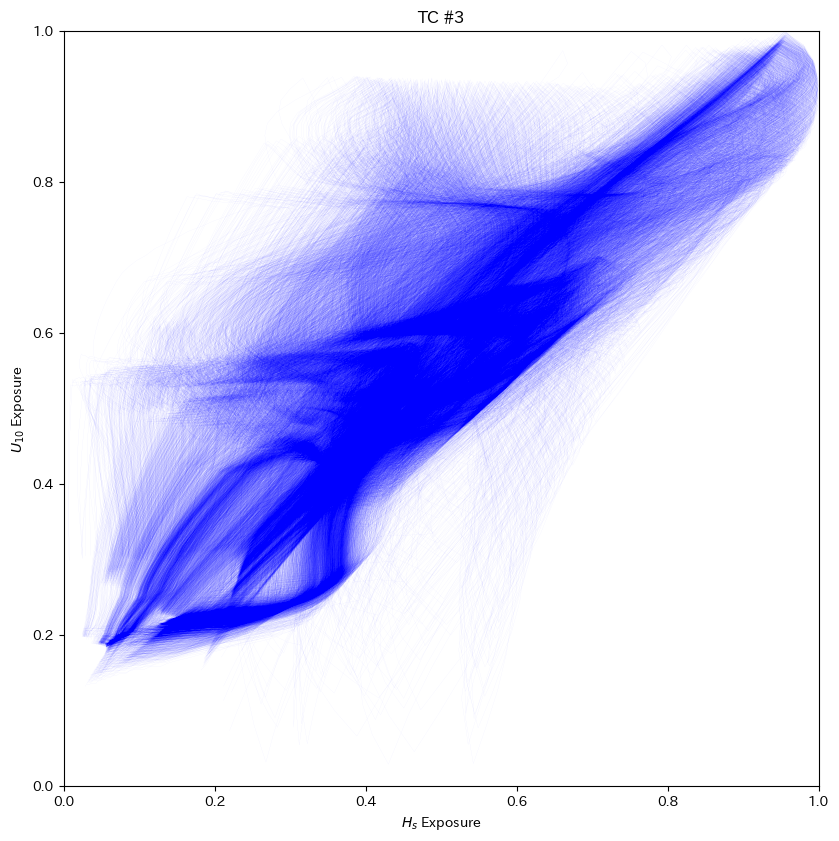

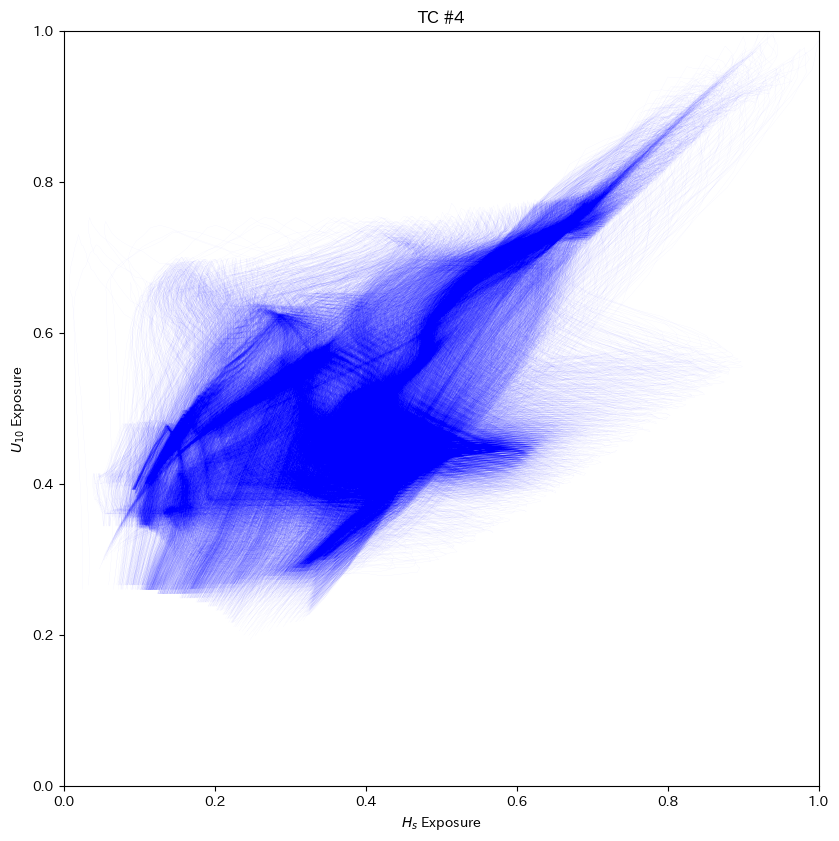

...

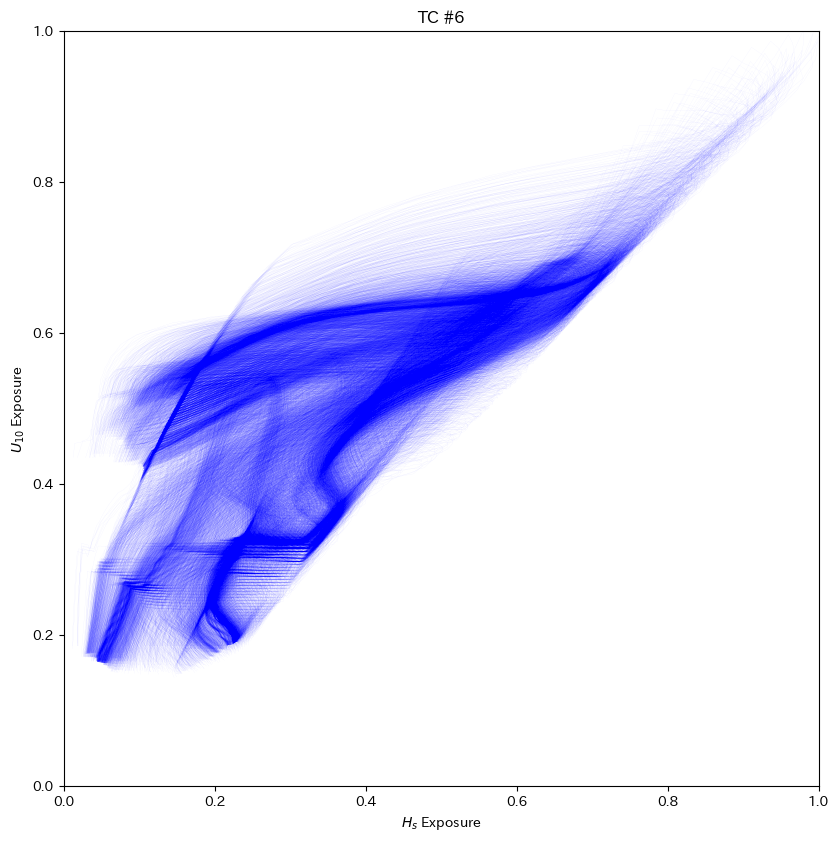

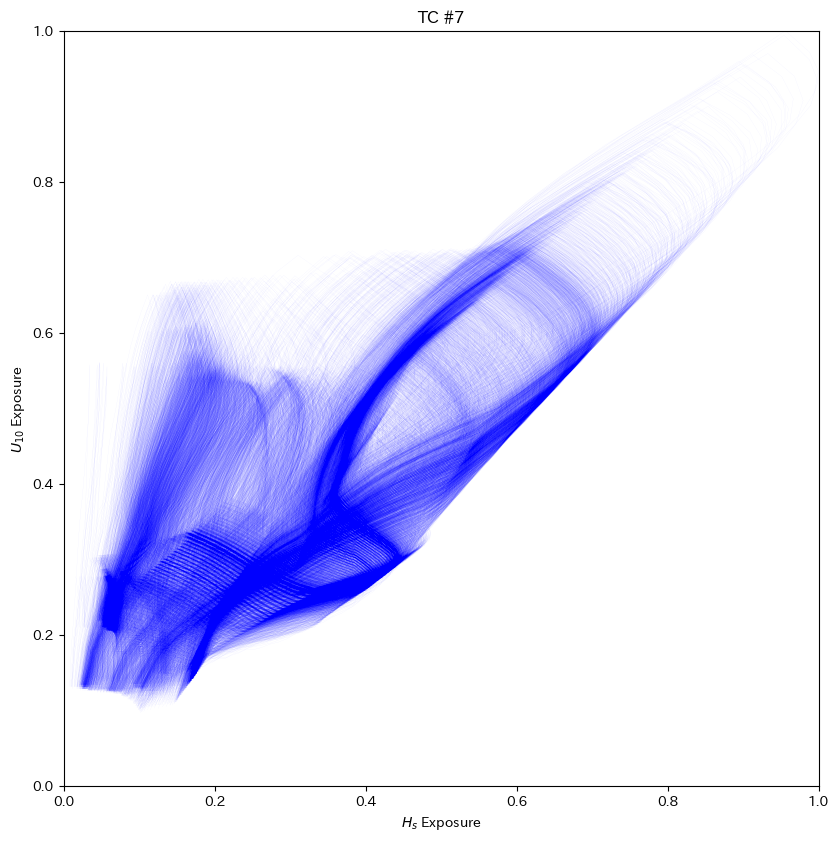

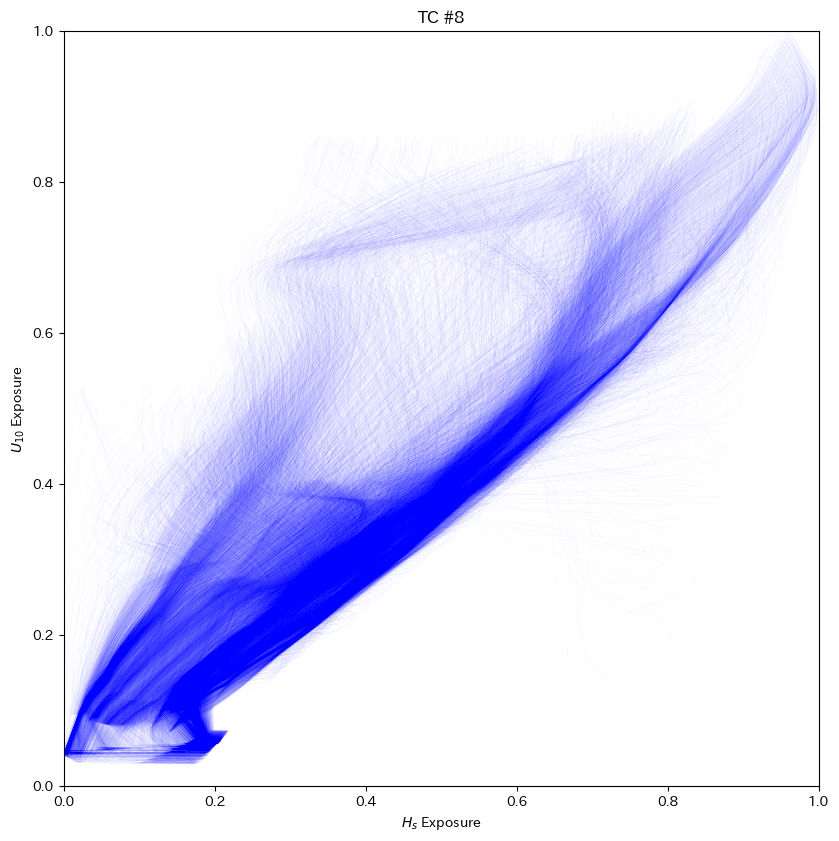

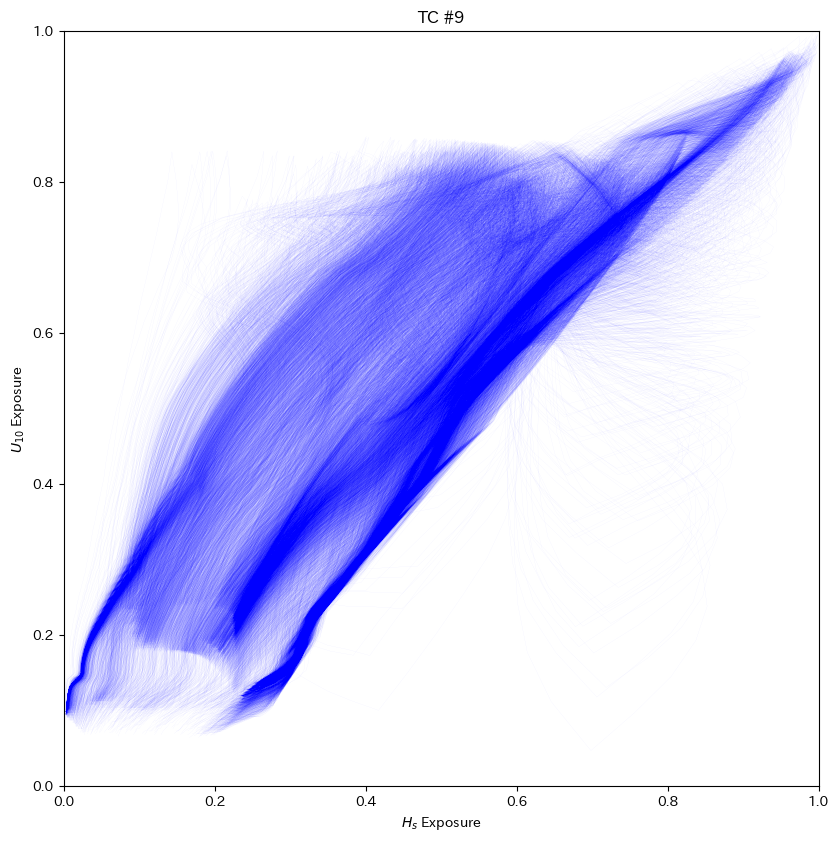

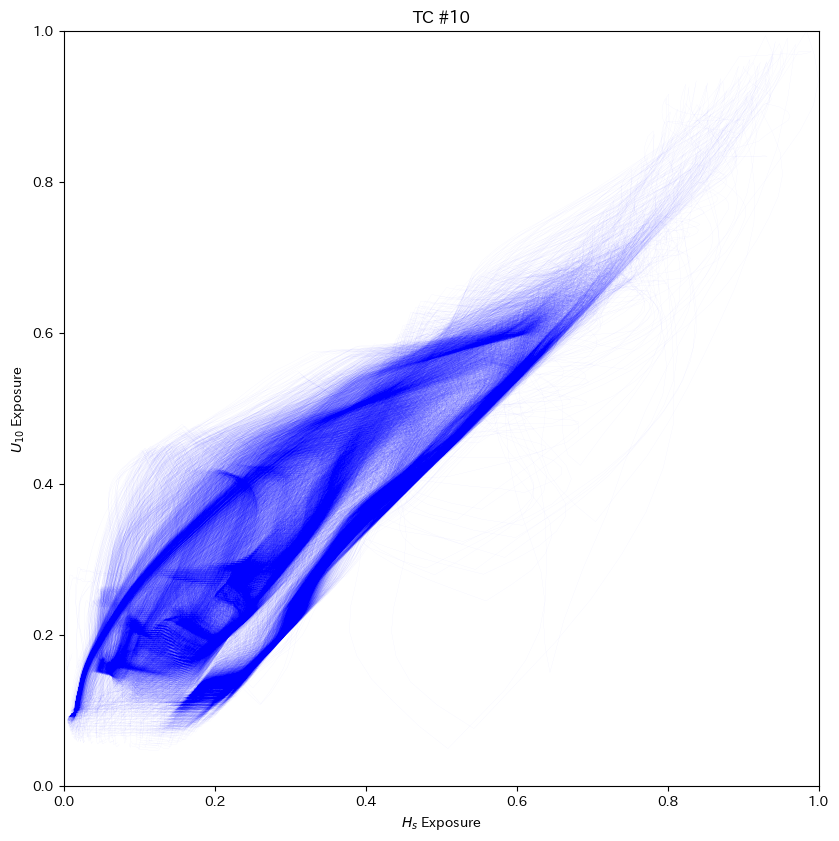

Error in callback <function flush_figures at 0x000001EE5FA13F70> (for post_execute):


KeyboardInterrupt: 

In [ ]:
# ev_num = 1

for ev_num in range(num_events):
  fig,ax=plt.subplots(figsize=(10,10),dpi=100,facecolor='white')
  for pos in range(num_nodes):
    # ax.scatter(exp[i][0,0,pos], exp[i][1,0,pos], color = 'orange')
    ax.plot(exp[ev_num][0,:,pos], exp[ev_num][1,:,pos], color = 'blue', lw=0.1, alpha=0.1)
  ax.set_xlim(0,1)
  ax.set_ylim(0,1)
  ax.set_aspect('equal')
  ax.set_xlabel('$H_s$ Exposure')
  ax.set_ylabel('$U_{10}$ Exposure')
  ax.set_title(f'TC #{ev_num}')
  plt.savefig(f"./output/exposure_test/TC{ev_num}.png", bbox_inches="tight")


In [ ]:
pos = 0
exp_vec = []
for i in range(num_events):
  _num_time = exp[i].shape[1]
  _vec = np.zeros((num_vars,_num_time-1))
  
  for ti in range(_num_time-1):
    _vec[:,ti] = exp[i][:,ti+1,pos]-exp[i][:,ti,pos]
  exp_vec.append(_vec)

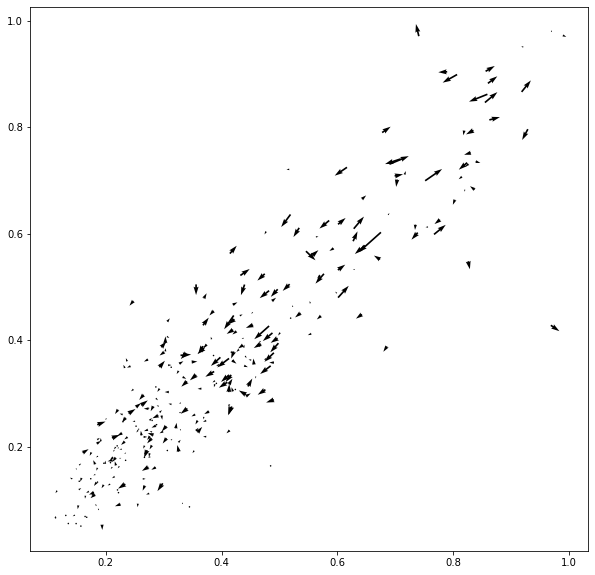

In [ ]:
fig,ax=plt.subplots(figsize=(10,10), facecolor='white')
t = 100
duration = []
for i in range(num_events):
  duration.append(exp[i].shape[1])
  if exp[i].shape[1] > t+1:
    ax.quiver(exp[i][0,t,pos], 
              exp[i][1,t,pos],
              exp_vec[i][0,t],
              exp_vec[i][1,t],
              scale=1,
              width=0.003, 
              headwidth=3,
              alpha=1)

(array([ 43., 195., 127.,  72.,  24.,   8.,   2.,   2.,   1.,   3.]),
 array([ 11. ,  65.7, 120.4, 175.1, 229.8, 284.5, 339.2, 393.9, 448.6,
        503.3, 558. ]),
 <BarContainer object of 10 artists>)

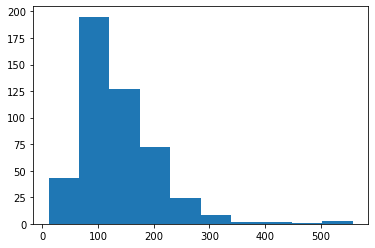

In [ ]:
plt.hist(duration)

In [ ]:
vec_len = []
for i in range(num_events):
  _len = np.sqrt(exp_vec[i][0,:]**2 + exp_vec[i][1,:]**2)
  vec_len.extend(_len.tolist())

(array([2.3770e+04, 1.9403e+04, 1.0194e+04, 5.2190e+03, 2.6570e+03,
        1.4300e+03, 8.0100e+02, 5.0900e+02, 3.0900e+02, 1.5600e+02,
        1.1300e+02, 6.4000e+01, 4.3000e+01, 1.0000e+01, 2.0000e+01,
        7.0000e+00, 3.0000e+00, 3.0000e+00, 1.0000e+00, 0.0000e+00,
        1.0000e+00, 0.0000e+00, 1.0000e+00, 1.0000e+00, 1.0000e+00,
        2.0000e+00, 1.0000e+00, 1.0000e+00, 0.0000e+00, 1.0000e+00,
        0.0000e+00, 1.0000e+00, 1.0000e+00, 1.0000e+00, 1.0000e+00,
        1.0000e+00, 1.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+00,
        1.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+00]),
 array([0.        , 0.00577153, 0.01154306, 0.01731458, 0.02308611,
        0.02885764, 0.03462917, 0.04040069, 0.04617222, 0.05194375,
        0.05771528, 0.0634868 , 0.06925833, 0.07502986, 0.08080139,
        0.08657292, 0.09234444, 0.09811597, 0.1038875 , 0.10965903,
        0.11543055, 0.12120208, 0.12697361, 0.

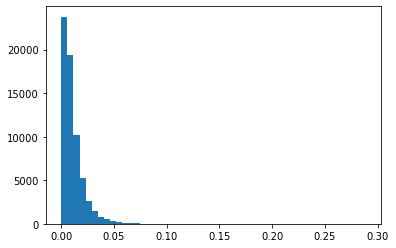

In [ ]:
plt.hist(vec_len,bins=50)

In [ ]:
_a = np.array([1,2,3])
_b = np.array([1,2,3])
np.sqrt(_a**2 +_b**2)

array([1.41421356, 2.82842712, 4.24264069])

# Each Location, multiple cell

Text(0.0, 1.0, 'Exposure trajectory for TC#0 at Location 3823: (12.1665,-64.9086)')

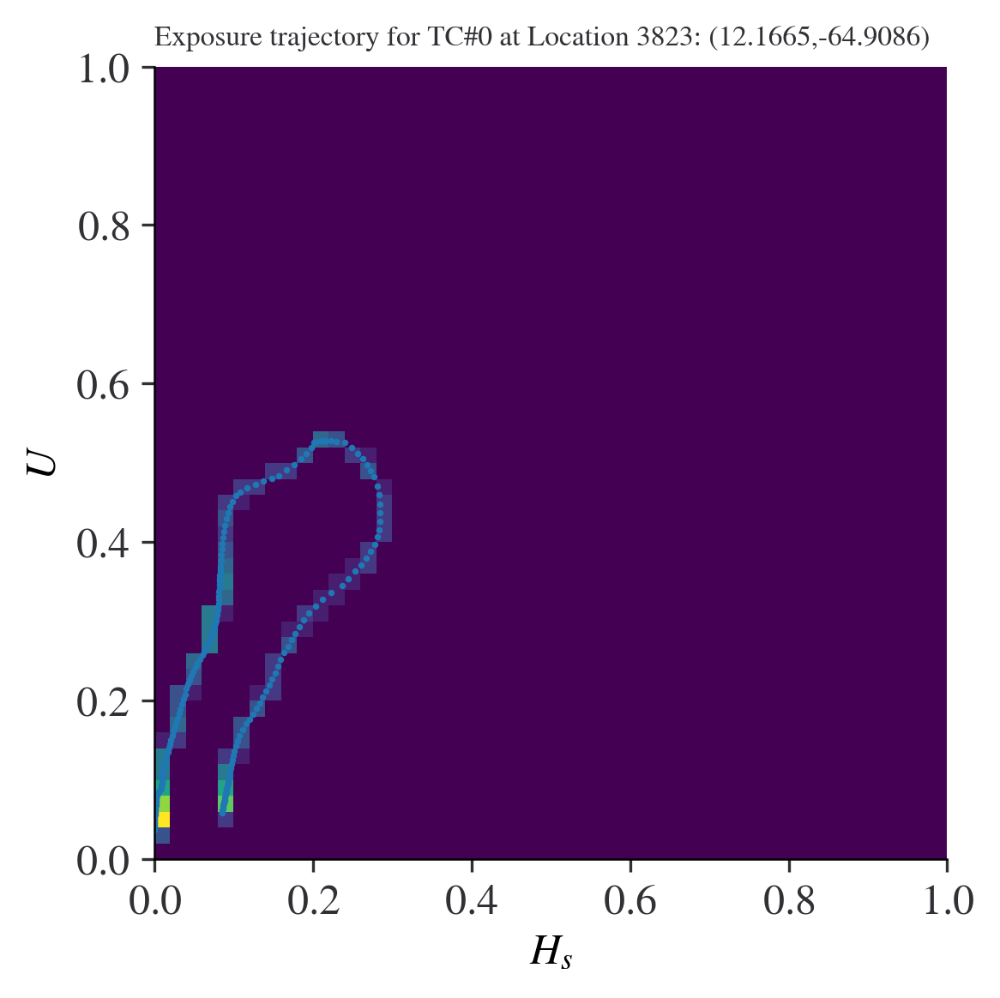

In [7]:
res = 50
dist_method = ["MD", "Hausdorff"]
di = 0

# [0,1]
_bins = np.linspace(0, 1, res, endpoint=False)

k_dict = {
  "k_null": [],
  "k": [],
}

pi = 0
pos = pos_list[pi]
vi = 0

num_events_ext = np.count_nonzero(mstme.is_e[vi])
stm_ext = mstme.stm[vi, mstme.is_e[vi]]
exp_series_ext = [exp_series[i] for i in np.where(mstme.is_e[vi])[0]]

# Quantize
# fig_q, ax_q = plt.subplots(
exp_array = np.zeros((num_events_ext, res, res))
for ei in range(num_events_ext):
    h = exp_series_ext[ei].isel(node=pos)["hs"]
    u = exp_series_ext[ei].isel(node=pos)["UV_10m"]
    # subtract 1 from digitize because 0.0~0.1 will return 1 and 0.9~1.0 will return res(and will cause indexerror)
    _exp_digitized = np.digitize(np.array([h, u]).T, _bins) - 1

    array = np.zeros((res, res))
    for cell in _exp_digitized:
        try:
            array[cell[0], cell[1]] += 1
        except IndexError:
            print(ei, cell)
    exp_array[ei, :, :] = array

fig, ax = plt.subplots(1, 1, figsize=(4, 4))

ei = 0
ax.imshow(exp_array[ei].T, origin="lower", extent=(0, 1, 0, 1))
ax.scatter(
    exp_series_ext[ei].isel(node=pos)["hs"],
    exp_series_ext[ei].isel(node=pos)["UV_10m"],
    s=1,
)
ax.set_xlabel(var_name[0])
ax.set_ylabel(var_name[1])
ax.set_title(
    f"Exposure trajectory for TC#{ei} at Location {pos}: ({mstme.latlon[pos,0]:.4f},{mstme.latlon[pos,1]:.4f})",
    size=8,
)

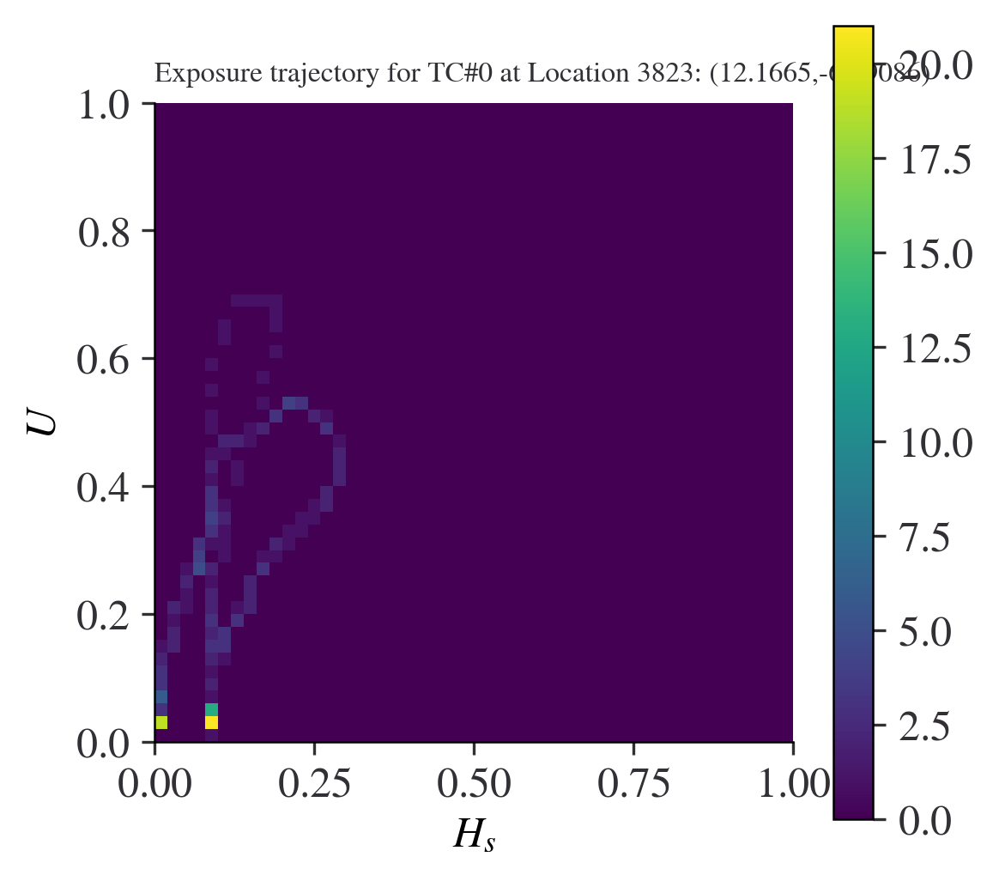

In [11]:
fig, ax = plt.subplots(1, 1, figsize=(4, 4))

ei = 0
im=ax.imshow(np.abs(exp_array[ei].T-exp_array[ei+1].T)
             , origin="lower", extent=(0, 1, 0, 1))
# ax.scatter(
#     exp_series_ext[ei].isel(node=pos)["hs"],
#     exp_series_ext[ei].isel(node=pos)["UV_10m"],
#     s=1,
# )
ax.set_xlabel(var_name[0])
ax.set_ylabel(var_name[1])
ax.set_title(
    f"Exposure trajectory for TC#{ei} at Location {pos}: ({mstme.latlon[pos,0]:.4f},{mstme.latlon[pos,1]:.4f})",
    size=8,
)
plt.colorbar(im)